<hr style="height: 1px;">
<i>This notebook was authored by the 8.S50x Course Team, Copyright 2022 MIT All Rights Reserved.</i>
<hr style="height: 1px;">
<br>

<h1>Pset 4: Problems Using Numerical Simulation</h1>


<a name='section_4_0'></a>
<hr style="height: 1px;">


## <h2 style="border:1px; border-style:solid; padding: 0.25em; color: #FFFFFF; background-color: #90409C">P4.0 Overview</h2>


<h3>Navigation</h3>

<table style="width:100%">
    <tr>
        <td style="text-align: left; vertical-align: top; font-size: 10pt;"><a href="#section_4_1">P4.1 Double Pendulum</a></td>
        <td style="text-align: left; vertical-align: top; font-size: 10pt;"><a href="#problems_4_1">P4.1 Problems</a></td>
    </tr>
    <tr>
        <td style="text-align: left; vertical-align: top; font-size: 10pt;"><a href="#section_4_2">P4.2 Lattice-Boltzmann Simulation</a></td>
        <td style="text-align: left; vertical-align: top; font-size: 10pt;"><a href="#problems_4_2">P4.2 Problems</a></td>
    </tr>
    <tr>
        <td style="text-align: left; vertical-align: top; font-size: 10pt;"><a href="#section_4_3">P4.3 Maxwell-Boltzmann Distribution from Molecular Simulation</a></td>
        <td style="text-align: left; vertical-align: top; font-size: 10pt;"><a href="#problems_4_3">P4.3 Problems</a></td>
    </tr>
    <tr>
        <td style="text-align: left; vertical-align: top; font-size: 10pt;"><a href="#section_4_4">P4.4 Ideal Gas Law from Molecular Simulation</a></td>
        <td style="text-align: left; vertical-align: top; font-size: 10pt;"><a href="#problems_4_4">P4.4 Problems</a></td>
    </tr>
    <tr>
        <td style="text-align: left; vertical-align: top; font-size: 10pt;"><a href="#section_4_5">P4.5 Galaxy Rotation Curves</a></td>
        <td style="text-align: left; vertical-align: top; font-size: 10pt;"><a href="#problems_4_5">P4.5 Problems</a></td>
    </tr>
</table>



<h3>Learning Objectives</h3>

In these problems, we will explore several examples utilizing numerical simulation. For each case, there will be several questions which lead to building a full-fledged simulation of the physical system or computational task under consideration.

In the first part, we will simulate a dynamical system, the double-pendulum. This simple system exhibits rich behavior and it one of the prototypical examples of chaos.

In the second part, we will investigate the flow of momentum on a lattice using a Lattice-Boltzmann simulation.

The final parts, we will focus on a 2D ideal gas simulation through particle-level simulation. We will derive famous distributions and relations such as Boltzmann distribution, Gay-Lussac's law, Avogadro's Law, Boyle's law, and by combining them all, ideal gas relation in two dimensions.


<h3>Importing Libraries</h3>

Before beginning, run the cell below to import the relevant libraries for this notebook.

In [ ]:
#>>>RUN: P4.0-runcell00

#install the following:

#conda install -c conda-forge imageio
#pip install imageio
#pip3 install torch torchvision torchaudio

In [42]:
#>>>RUN: P4.0-runcell01

import itertools
from IPython.display import HTML
from scipy.integrate import odeint
import matplotlib.patches as patches
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import animation
from matplotlib.animation import PillowWriter
import imageio
from IPython.display import Image
import random

<h3>Setting Default Figure Parameters</h3>

The following code cell sets default values for figure parameters.

In [ ]:
#>>>RUN: P4.0-runcell02

#set plot resolution
%config InlineBackend.figure_format = 'retina'

#set default figure parameters
plt.rcParams['figure.figsize'] = (9,6)

medium_size = 12
large_size = 15

plt.rc('font', size=medium_size)          # default text sizes
plt.rc('xtick', labelsize=medium_size)    # xtick labels
plt.rc('ytick', labelsize=medium_size)    # ytick labels
plt.rc('legend', fontsize=medium_size)    # legend
plt.rc('axes', titlesize=large_size)      # axes title
plt.rc('axes', labelsize=large_size)      # x and y labels
plt.rc('figure', titlesize=large_size)    # figure title


<a name='section_4_1'></a>
<hr style="height: 1px;">

## <h2 style="border:1px; border-style:solid; padding: 0.25em; color: #FFFFFF; background-color: #90409C">P4.1 Double Pendulum</h2>    

| [Top](#section_4_0) | [Previous Section](#section_4_0) | [Problems](#problems_4_1) | [Next Section](#section_4_2) |


<h3>Overview</h3>

The double pendulum is a system in classical mechanics where one pendulum is attached to the end of another pendulum. Its equations of motion are usually expressed using the Lagrangian mechanics and solved numerically, which is what we will do in this problem

In [ ]:
#Below is a reworking of
#https://scipython.com/blog/the-double-pendulum/
#https://github.com/zaman13/Double-Pendulum-Motion-Animation/blob/master/Python%20Code/Double_Pendulum_v1.py

## Setting up the differential equations to be solved

def theta1ddot(theta1,theta1dot,theta2,theta2dot,m,ell,g):
        st1t2=np.sin(theta1-theta2)
        ct1t2=np.cos(theta1-theta2)
        term1=-m*ell**2*st1t2*(ct1t2*theta1dot**2 + theta2dot**2)
        term2= m*g*ell*(-2*np.sin(theta1)+np.sin(theta2)*ct1t2)
        denom=m*ell**2*(1+st1t2**2)
        return (term1+term2)/denom

def theta2ddot(theta1,theta1dot,theta2,theta2dot,m,ell,g):
        st1t2=np.sin(theta1-theta2)
        ct1t2=np.cos(theta1-theta2)
        term1=m*ell**2*st1t2*(ct1t2*theta2dot**2 + 2*theta1dot**2)
        term2=2*m*g*ell*(-np.sin(theta2)+np.sin(theta1)*ct1t2)
        denom=m*ell**2*(1+st1t2**2)
        return (term1+term2)/denom


def ode(y, t, l, m, g):
    """Return the first derivatives of y = theta1, z1, theta2, z2."""
    theta1, theta1dot, theta2, theta2dot = y
    t1ddt=theta1ddot(theta1,theta1dot,theta2,theta2dot,m,l,g)
    t2ddt=theta2ddot(theta1,theta1dot,theta2,theta2dot,m,l,g)
    return theta1dot,t1ddt,theta2dot,t2ddt

def energy(y,l,m,g):
    theta1, theta1dot, theta2, theta2dot = y.T # Note the.T transposes it so we can unpack
    ct1t2=np.cos(theta1-theta2)
    U=-2*m*g*l*np.cos(theta1)-m*g*l*np.cos(theta2)
    K=m*l**2*theta1dot**2+m*l**2/2*(theta2dot**2+2*theta1dot*theta2dot*ct1t2)
    return K+U

## set up pendulum parameters
l=5#m
m=1#kg
g=9.8#kgm/s^2

<a name='problems_4_1'></a>     

| [Top](#section_4_0) | [Restart Section](#section_4_1) | [Next Section](#section_4_2) |


### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.1.1</span>

Later in this problem when doing the numerics, one parameter we can easily calculate is the energy of the system. Before doing any numerics, is energy conserved in this system?


<div style="border:1.5px; border-style:solid; padding: 0.5em; border-color: #90409C; color: #90409C;">

**SOLUTION:**

<pre>
Yes
</pre>
        
**EXPLANATION:**
    

  
    
</div>


### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.1.2</span>

Report the total energy for systems with the following initial conditions (consider four separate cases and report your answer as a list of number with precision 1e-1): `[energy case1, energy case2, energy case3, energy case4]`

Case 1: no initial amplitude, no initial angular velocity\
Case 2: small initial amplitude of pendulum 1 only (other initial conditions zero): `theta1=0.02*pi`\
Case 3: larger initial amplitude of both pendula (angular velocities zero): `theta1=0.3*pi`, `theta2=0.2*pi`\
Case 4: nearly vertical (angular velocities zero): `theta1=0.9*pi`, `theta2=*pi`

In [ ]:
#>>>PROBLEM: P4.1.2
# Use this cell for drafting your solution (if desired),
# then enter your solution in the interactive problem online to be graded.

#define arrays for the 4 cases by setting the initial conditions in y0,
#e.g., y0_case1=np.array([theta1_case1, theta1dot_case1, theta2_case1, theta2dot_case1])

y0_case1 = #YOUR CODE HERE
y0_case2 = #YOUR CODE HERE
y0_case3 = #YOUR CODE HERE
y0_case4 = #YOUR CODE HERE

#print the energy for each case, using `energy(y,l,m,g)`

In [ ]:
#>>>SOLUTION: P4.1.2

## SOLUTION
y0_case1=np.array([0,0,0,0])
y0_case2=np.array([np.pi*0.02,0,np.pi*0.0,0])
y0_case3=np.array([np.pi*0.3,0,np.pi*0.2,0])
y0_case4=np.array([np.pi*0.9,0,np.pi*1,0])

## answer [-147,-146.8,-97.2,142.2]
print('\n',
    'Case 1:', energy(y0_case1,l,m,g),'\n',
    'Case 2:', energy(y0_case2,l,m,g),'\n',
    'Case 3:', energy(y0_case3,l,m,g),'\n',
    'Case 4:', energy(y0_case4,l,m,g)
    )

### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.1.3</span>

Before doing a simulation, it can be useful to think about test cases where you know the answer to check your simulation outputs. One simple way to decompose a system is into normal modes.


Which of the following statements is true about the normal modes of a double-pendulum system?

A) There is only one normal mode, which is called the out-of-phase mode.\
B) There are two normal modes, which are called the in-phase mode and the out-of-phase mode.\
C) There are three normal modes, which are called the in-phase mode, the out-of-phase mode, and the chaotic mode.\
D) There are four normal modes, which are called the in-phase mode, the out-of-phase mode, the chaotic mode, and the stable mode.



<div style="border:1.5px; border-style:solid; padding: 0.5em; border-color: #90409C; color: #90409C;">

**SOLUTION:**

<pre>
B
</pre>
        
**EXPLANATION:**

The double-pendulum has two normal modes of motion: in-phase and out-of-phase.
    
The in-phase mode is where both pendulums oscillate in phase with each other, meaning that they move in the same direction at the same time. In this mode, the two pendulums are at the same height at the same time, and their motion is symmetric about the vertical axis. The frequency of the in-phase mode is lower than the frequency of the out-of-phase mode.

The out-of-phase mode is where the two pendulums oscillate out of phase with each other, meaning that they move in opposite directions at the same time. In this mode, the two pendulums have a phase difference of 180 degrees, and their motion is asymmetric about the vertical axis. The frequency of the out-of-phase mode is higher than the frequency of the in-phase mode.

It is important to note that the normal modes of the double-pendulum system are only valid for small oscillations around the stable equilibrium position. For larger oscillations, the system's motion becomes chaotic and unpredictable.
</div>


<h3>Run the Simulation</h3>

Now run the cells below to see the simulation.

In [ ]:
## Solve the differenial equation with odeint and make a video of the bob's motion
def run(y0):

    # y0 is the initial conditions theta1, theta1dot, theta2, theta2dot = y
    # for example y0=np.array([np.pi*0.1,0,np.pi*0.2,0])

    #Time
    tmax=30#s
    dt=1e-2#s
    t=np.arange(0, tmax+dt, dt)

    #The works
    y = odeint(ode, y0, t, args=(l,m,g))
    #print(y)

    #the check
    en=energy(y,l,m,g)

    return t,y,en


#===========Plotting
def make_plot(i,y,l,g,ax,fig,images):
    plt.cla()
    # Plot and save an image of the double pendulum configuration for time
    # point i.
    # The pendulum rods.
    theta1=y[:,0]
    theta2=y[:,2]
    x1 = l  * np.sin(theta1)
    y1 = -l * np.cos(theta1)
    x2 = x1 + l * np.sin(theta2)
    y2 = y1 - l * np.cos(theta2)
    ax.plot([0, x1[i], x2[i]], [0, y1[i], y2[i]], lw=2, c='k')

    # Circles representing the anchor point of rod 1, and bobs 1 and 2.
    r = 0.35
    c0 = patches.Circle((0, 0), r/2, fc='k', zorder=10)
    c1 = patches.Circle((x1[i], y1[i]), r, fc='b', ec='b', zorder=10)
    c2 = patches.Circle((x2[i], y2[i]), r, fc='r', ec='r', zorder=10)
    ax.add_patch(c0)
    ax.add_patch(c1)
    ax.add_patch(c2)

    # The trail will be divided into ns segments and plotted as a fading line.
    ns = 20
    trail_secs = 1
    dt=1e-2#s
    max_trail = int(1 / dt)
    s = max_trail // ns

    for j in range(ns):
        imin = i - (ns-j)*s
        if imin < 0:
            continue
        imax = imin + s + 1
        # The fading looks better if we square the fractional length along the
        # trail.
        alpha = (j/ns)**2
        ax.plot(x2[imin:imax], y2[imin:imax], c='r', solid_capstyle='butt',
                lw=2, alpha=alpha)

    # Centre the image on the fixed anchor point, and ensure the axes are equal
    ax.set_xlim(-l-l-r, l+l+r)
    ax.set_ylim(-l-l-r, l+l+r)
    ax.set_aspect('equal', adjustable='box')
    plt.axis('off')
    fps = 10
    di = int(1/fps/dt)
    # plt.savefig('frames/_img{:04d}.png'.format(i//di), dpi=72)
    # plt.cla()
    #plt.show()
    fig.canvas.draw()       # draw the canvas, cache the renderer
    image = np.frombuffer(fig.canvas.tostring_rgb(), dtype='uint8')
    image  = image.reshape(fig.canvas.get_width_height()[::-1] + (3,))
    images.append(image)

In [ ]:
#set the initial conditions and run the simulation

#Define a new y0, or test cases defined previously
#e.g.,y0=y0_case1
#y0 = #YOUR CODE HERE

y0=y0_case3

t,y,en=run(y0)

fps = 1000
dt=.0001
di = int(1/fps/dt)
fig = plt.figure(figsize=(8.3333, 6.25), dpi=72)
ax = fig.add_subplot(111)

# Create the output of the simulation, stored in the variable `images`
images=[]
for i in range(0, t.size, di):
    #print(i // di, '/', t.size // di)
    make_plot(i,y,l,g,ax,fig,images)


# Comment out plt.close() to view the last image from the simulation, if desired
plt.close()

#save the gif
imageio.mimsave('./double_p.gif', images, fps=10)

In [ ]:
# VIEW THE GIF
# comment out the line and run again to hide

#Image(open('double_p.gif','rb').read())

In [ ]:
## plot the bobs' angles vs time and energy
## use previously defined y0, above

plt.plot(t,y[:,0],color='blue')
plt.plot(t,y[:,2],color='red')
plt.xlabel("Time [seconds]")
plt.ylabel(r"$\theta$")
plt.show()


plt.plot(t,en,color='blue')
plt.xlabel("Time [seconds]")
plt.ylabel("Energy")
plt.show()

fig = plt.figure(figsize=(8.3333, 6.25), dpi=72)
ax = fig.add_subplot(111)
make_plot(10,y,l,g,ax,fig,images)
plt.show()

### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.1.4</span>

For each of the following initial conditions, describe the bob's motion. To do this, edit and run the relevant code above and analyze plots of $\theta$ vs. $t$ for each case.

<pre>
#initial conditions:
y0_case1=np.array([0,0,0,0])
y0_case2=np.array([np.pi*0.02,0,np.pi*0.0,0])
y0_case3=np.array([np.pi*0.3,0,np.pi*0.2,0])
y0_case4=np.array([np.pi*.9,0,np.pi*1,0])
</pre>

Select your answer for each case from the following options:

A) Stationary\
B) Each bob oscillates at a single frequency\
C) Each bob oscillates periodically and displays beats\
D) One bob oscillates periodically and one bob oscillates chaotically\
E) Both bobs oscillate chaotically


Enter your answer as a list of **uppercase** letters, corresponding to the correct choices for each set of initial conditions, i.e.: `[answer case1, answer case2, answer case3, answer case4 ]` should be entered as, e.g., `['A','B','C','D']`, where the letters are **capitalized** and listed as strings.

In [ ]:
## SOLUTION

y0_case1=np.array([0,0,0,0])
y0_case2=np.array([np.pi*0.02,0,np.pi*0.0,0])
y0_case3=np.array([np.pi*0.3,0,np.pi*0.2,0])
y0_case4=np.array([np.pi*.9,0,np.pi*1,0])

#change the following line to view each case:
t,y,en=run(y0_case4)

plt.plot(t,y[:,0],color='blue')
plt.plot(t,y[:,2],color='red')
plt.xlabel("Time [seconds]")
plt.ylabel(r"$\theta$")
plt.show()


<div style="border:1.5px; border-style:solid; padding: 0.5em; border-color: #90409C; color: #90409C;">

**SOLUTION:**

<pre>
ANS: `['A','C','D,'E']`
</pre>
        
**EXPLANATION:**
    
We can tell chaotic motion by looking at the irregularity of the motion. Its clear that case4 is chaotic.
    
Case3 is mildly chaotic, where one pendulum is periodic and the other is irregular.
    

</div>


### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.1.5</span>


Is energy conserved during the evolution for each of the above initial conditions? Try plotting the energy in each case to determine your answer.

A) Yes.\
B) No, the energy fluctuates significantly as the pendula move.\
C) No, the energy decays significantly when the bobs are moving.

In [ ]:
## SOLUTION

y0_case1=np.array([0,0,0,0])
y0_case2=np.array([np.pi*0.02,0,np.pi*0.0,0])
y0_case3=np.array([np.pi*0.3,0,np.pi*0.2,0])
y0_case4=np.array([np.pi*.9,0,np.pi*1,0])

#change the following line to view each case:
t,y,en=run(y0_case2)

plt.plot(t,en,color='blue')
plt.ylim(np.min(en)-np.min(en)*0.01,np.max(en)+np.max(en)*0.01)
plt.xlabel("Time [seconds]")
plt.ylabel("Energy")
plt.show()


<div style="border:1.5px; border-style:solid; padding: 0.5em; border-color: #90409C; color: #90409C;">

**SOLUTION:**

<pre>
Yes
</pre>
        
**EXPLANATION:**
    
There are numerical fluctuations in the energy, but they are not significant. This is because ODEInt is a powerful integrator.
</div>


<a name='section_4_2'></a>
<hr style="height: 1px;">

## <h2 style="border:1px; border-style:solid; padding: 0.25em; color: #FFFFFF; background-color: #90409C">P4.2 Lattice-Boltzmann Simulation</h2>    

| [Top](#section_4_0) | [Previous Section](#section_4_1) | [Problems](#problems_4_2) | [Next Section](#section_4_3) |


<h3>Overview</h3>

Lattice Boltzmann modelling using grid systems.
Based on the below:
https://physics.weber.edu/schroeder/javacourse/LatticeBoltzmann.pdf

Also:
https://medium.com/swlh/create-your-own-lattice-boltzmann-simulation-with-python-8759e8b53b1c?source=user_profile---------4----------------------------

The goal of this project is to do a numerical modelling of the the flow momentum using a lattice. To perform this, we will rely on the fact that the momenta of particles are distributed following a Boltzmann distribution.

$$ D(\vec{v}) = \frac{m}{2\pi k T} e^{-\frac{mv^2}{kT}} $$

What this means is that when we look at a motionless system the migration in an out of grid is still happening.

Furthermore, what this means is that motion in and out can be depicted by the speed of sound in the gas, given by

$$ c_{s} = \sqrt{\langle v_{x}^2+v_{y}^2+v_{z}^2} = \sqrt{3\langle v_{x}^2\rangle}= \sqrt{\frac{3kT}{m}} $$

Mesoscopic model, which is in between microscopic model that describes particle positions and macroscopic models that describe velocity and density directly. LBM instead describes the probability of particles being in various locations.

The computational idea of the model invoves two steps: a collision step where particles reorganize and relax to equillibrium and a streaming step where the results of the collision are propogated and each cell is updated.

Weights determine the equillibrium density and are set by which model we choose. Changing the weights will change the results and here we choose the D2Q9 model, which tells us that we are working in dimension 2 and the density has 9 possible velocity vectors. The 9 possible velocity vectors correspond to the 8 adjacent cells about a center cell (ie 3x3 grid). Velocity motion can go on the diagonals, and as a result we have 8 possible motions to different cells and one stay motion.

The D2Q9 weights can be derived by integrating the boltzman distribution in the 9 possible directions.  Following the grid shown here: 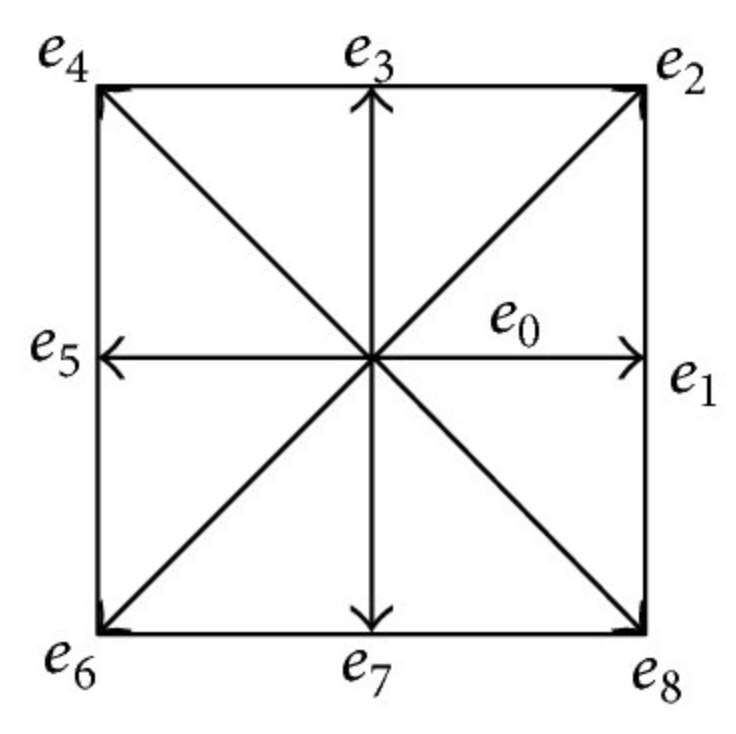

In [ ]:
idx = np.arange(9)
cxs = np.array([0, 0, 1, 1, 1, 0,-1,-1,-1]) ## for velocities in the x direction
cys = np.array([0, 1, 1, 0,-1,-1,-1, 0, 1]) ## for velocities in the y direction
ws  = np.array([4/9,1/9,1/36,1/9,1/36,1/9,1/36,1/9,1/36]) ## weights for D2Q9

In [ ]:
#Some references
#https://d-nb.info/1070218804/34
#https://github.com/KnairdA/LiterateLB/blob/master/lbm.org => This covers the problem and goes way deeper
#https://arxiv.org/pdf/1909.04502.pdf

In a lattice-Boltzmann simulation, the fundamental dynamical variables are the
nine different number densities of particles moving at the nine allowed velocities,
at each lattice site. Thus, your simulation will need nine two-dimensional arrays
of real numbers to represent these densities

At any given time, at a given lattice site, these nine densities can have any
positive values. From these values you can then compute the total density, ρ, as
well as the x and y components of the average (that is, macroscopic) velocity, ux
and uy

<a name='problems_4_2'></a>     

| [Top](#section_4_0) | [Restart Section](#section_4_2) | [Next Section](#section_4_3) |


### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.2.1</span>

Write a function to compute the total density at each lattice site, summing over the 9 allowed velocities.

In [ ]:
#>>>PROBLEM: P4.2.1
# Use this cell for drafting your solution (if desired),
# then enter your solution in the interactive problem online to be graded.

##
def globalRho(rho):
    # input is a density array (rho)
    #,2 index is over the velocity directions
    return #YOUR CODE HERE


#-----------------------------------------------------
# CHECK YOUR RESULT

#rho is a 3d array that is Nx x Ny x 9, where there are 9 Nx x Ny densities,
#and each of those densities has one of the 9 possible velocity options.

np.random.seed(42)

Nx=100
Ny = 100
NL = 9
var=0.01
rho = (np.ones((Ny,Nx,NL)) + var*np.random.randn(Ny,Nx,NL))
gRho = globalRho(rho)


print(rho.shape)
print(gRho.shape)

fig, ax = plt.subplots()
im = ax.imshow(gRho, cmap='plasma')
ax.set_title('Global Density')
fig.colorbar(im, ax=ax)
plt.show()

In [ ]:
#>>>SOLUTION: P4.2.1

def globalRho(rho):
    # input is a density array (rho)
    #,2 index is over the velocity directions
    return np.sum(rho,2)


#-----------------------------------------------------
# CHECK YOUR RESULT

#rho is a 3d array that is Nx x Ny x 9, where there are 9 Nx x Ny densities,
#and each of those densities has one of the 9 possible velocity options.

np.random.seed(42)

Nx=100
Ny = 100
NL = 9
var=0.01
rho = (np.ones((Ny,Nx,NL)) + var*np.random.randn(Ny,Nx,NL))
gRho = globalRho(rho)

# What are the shapes of the arrays
#print(rho.shape)
#print(gRho.shape)

# Plot the output of the function
fig, ax = plt.subplots()
im = ax.imshow(gRho, cmap='plasma')
ax.set_title('Global Density')
fig.colorbar(im, ax=ax)
plt.show()



<div style="border:1.5px; border-style:solid; padding: 0.5em; border-color: #90409C; color: #90409C;">

**SOLUTION:**

<pre>

</pre>
        
**EXPLANATION:**
    
This function, called `globalRho`, takes a density array `rho` as input, where the third index of the array represents the different velocity directions. The function returns a 2D array, where each element represents the sum of the density values along the third (velocity) dimension for the corresponding location in the first two dimensions. The result is a 2D array with the same shape as the first two dimensions of the `rho` array, where each element represents the sum of the density values for that location in space, regardless of the velocity direction.

The goal here is to sum over all of the velocities, but for a single cell. That gives us teh densities over everything.
    
</div>

### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.2.2</span>

Write a function to compute the velocity.

In [ ]:
#>>>PROBLEM: P4.2.2
# Use this cell for drafting your solution (if desired),
# then enter your solution in the interactive problem online to be graded.

def globalV(rho,gRho):
    # input is a density array (rho) and the total density gRho
    #,2 index is over the velocity directions
    ux = ##YOUR CODE HERE
    uy = ##YOUR CODE HERE
    return ux,uy

#-----------------------------------------------------
# CHECK YOUR RESULT

np.random.seed(42)

Nx=100
Ny = 100
NL = 9
var=0.01
rho = (np.ones((Ny,Nx,NL)) + var*np.random.randn(Ny,Nx,NL))
gRho = globalRho(rho)

gUx,gUy  = globalV(rho,gRho)

# What are the shapes of the arrays
print(gUx.shape)
#print(gUx.shape)

# Plot the output of the function
fig, ax = plt.subplots()
im = ax.imshow(gUx, cmap='plasma')
ax.set_title('Global Ux')
fig.colorbar(im, ax=ax)
plt.show()

In [ ]:
#>>>SOLUTION: P4.2.2

def globalV(rho,gRho):
    # input is a density array (rho) and the total density gRho
    #,2 index is over the velocity directions
    ux = np.sum(rho*cxs,2)/gRho
    uy = np.sum(rho*cys,2)/gRho
    return ux,uy


#-----------------------------------------------------
# CHECK YOUR RESULT

np.random.seed(42)

Nx=10
Ny = 10
NL = 9
var=0.01
rho = (np.ones((Ny,Nx,NL)) + var*np.random.randn(Ny,Nx,NL))
gRho = globalRho(rho)

gUx,gUy  = globalV(rho,gRho)

# What are the shapes of the arrays
#print(gUx.shape)
#print(gUy.shape)

# Plot the output of the function
fig, ax = plt.subplots()
im = ax.imshow(gUx, cmap='plasma')
ax.set_title('Global Ux')
fig.colorbar(im, ax=ax)
plt.show()

<div style="border:1.5px; border-style:solid; padding: 0.5em; border-color: #90409C; color: #90409C;">

**SOLUTION:**

<pre>

</pre>
        
**EXPLANATION:**
    
This function, called `globalV`, takes a density array `rho` and the total density `gRho` as input. The `rho` array has the same shape as the density array in the `globalRho` function, where the third index represents the different velocity directions. The function returns two 2D arrays, `ux` and `uy`, representing the average velocity in the x and y directions, respectively, calculated using the density array and the total density.
    
The goal here is to get the density weighted velocity over the sample. The strategy is thus to sum over all velocity directions times their density. Note that, in this model, the velocity is just a constant.
    
</div>

Now we will rearrange the Boltzmann distribution, which tells us the probability that a particle has a particular thermal velocity, $\vec{v}$, into a form useful for our simulation. The total velocity determined by our simulation is one of the nine options from D2Q9. We will constrain our total velocity $\vec{u}+\vec{v}$, which is the sum of the flow velocity $\vec{u}$ and the thermal velocity $\vec{v}$ to be equal to $c \vec{e}_i$.

We can rearannge the probability distribution function to become

$D(\vec{v})→ \frac{m}{2\pi k T} e^{-\frac{m}{2kT}|\vec{e}_i c - \vec{u}|^2}$

Further, we require that $v << c$ so that particles do not have an appreciable chance to move 2 lattice steps per time step. By expanding square term in the exponential and then taylor expanding each term, we find the first factor corresponds to the probability of having velocity $c \vec{e_i}$ when the flow velocity is 0, which is exactly the weight $w_i$.

This leads to the equation

$D(\vec{v})→ w_i \big( 1 + \frac{3 \vec{e_i} \cdot \vec{u}}{c} + \frac{9}{2} (\frac{\vec{e_i} \cdot \vec{u}}{c})^2 -\frac{3}{2}\frac{|\vec{u}|^2}{c}  \big) $

From here on, we will set the speed of sound to 1, $c=1$. This is effectively our new Boltzman distribution when we know have a wind of velocity $\vec{u}$.

### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.2.3</span>

What is the equation for the equillibrium density? Express your answer using `Dv` for the probability density $D(\vec{v})$, and `rho` for the density $\rho$.

<div style="border:1.5px; border-style:solid; padding: 0.5em; border-color: #90409C; color: #90409C;">

**SOLUTION:**

<pre>
`rhoeq=Dv*rho`
</pre>
        
        
**EXPLANATION:**
    
This is just taking the above equilibrium equation and converting this to a density noting the flow of energy:
    
$$
\rho_{eq} = \rho w_{i} \left(1+3\vec{e}_{i}\cdot\vec{u}+\frac{9}{2}\vec{e}_{i}\cdot\vec{u}-\frac{3}{2}|\vec{u}|^2\right)
$$
    
    
</div>

### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.2.4</span>

Complete the code below to update `rho` in the simulation. To do this, define `rhoeq_func` using the definition of the equillibrium density derived above.

In [ ]:
#>>>PROBLEM: P4.2.4
# Use this cell for drafting your solution (if desired),
# then enter your solution in the interactive problem online to be graded.

def rhoeq_func(w,gRho,cx,cy,gUx,gUy):
    return #YOUR CODE HERE

def updateRho(rho,gRho,gUx,gUy,step):
    rhoeq=np.zeros(rho.shape)
    for i,cx,cy,w in zip(idx,cxs,cys,ws):
        rhoeq[:,:,i] = rhoeq_func(w,gRho,cx,cy,gUx,gUy)
    rho += step*(rhoeq-rho)
    return rho


In [ ]:
#>>>SOLUTION: P4.2.4

def rhoeq_func(w,gRho,cx,cy,gUx,gUy):
    return w*gRho*(1+3*(cx*gUx+cy*gUy)+0.5*9*(cx*gUx+cy*gUy)**2+0.5*3*(gUx**2+gUy**2))

def updateRho(rho,gRho,gUx,gUy,step):
    rhoeq=np.zeros(rho.shape)
    for i,cx,cy,w in zip(idx,cxs,cys,ws):
        rhoeq[:,:,i]=rhoeq_func(w,gRho,cx,cy,gUx,gUy)#w*gRho*(1+3*(cx*gUx+cy*gUy)+0.5*9*(cx*gUx+cy*gUy)**2+0.5*3*(gUx**2+gUy**2))
    rho += step*(rhoeq-rho)
    return rho


#-----------------------------------------------------
# CHECK YOUR RESULT


<div style="border:1.5px; border-style:solid; padding: 0.5em; border-color: #90409C; color: #90409C;">

**SOLUTION:**

<pre>
See solution code
</pre>
        
**EXPLANATION:**
    
The function calculates the equilibrium density for each velocity direction using the formula for the single-relaxation-time lattice Boltzmann method.

Specifically, `rhoeq_func` takes six input parameters: `w`, `gRho`, `cx`, `cy`, `gUx`, and `gUy`. These parameters represent the weight, total density, x and y components of the velocity direction, and the x and y components of the macroscopic velocity, respectively. The function returns a 3D array with the same shape as the weight array `w`, representing the equilibrium density for each velocity direction.
    
</div>

In [ ]:
#>>>RUN

## Other code DESCRBE WHY THIS CODE MATTERS
def moveParts(rho):
    for i,cx,cy in zip(idx,cxs,cys):
        #Shift each velocity index by appropriate neighbor density
        rho[:,:,i] = np.roll(rho[:,:,i],cx,axis=1)
        rho[:,:,i] = np.roll(rho[:,:,i],cy,axis=0)

def vorticity(ux,uy):
    #input is ux and uy grids
    #output is vorticity grid
    #nabla\times u
    #0.5(u(x+dx)-u(x-dx)) - (u(y+dy)-u(y-dy))
    vort = 0.5*(np.roll(ux,-1,axis=0)-np.roll(ux,1,axis=0) -(np.roll(uy,-1,axis=0)-np.roll(uy,1,axis=0)))
    return vort


### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.2.5</span>

Complete the following function, the purpose of which is to implement reflecting boundary conditions by updating the density values at the boundary with the reflected values.

The function selects the rows of the `rhoOld` array that correspond to the boundary, and assigns it to a variable called `bndryRho` (this is already done). The function should then select the columns of `bndryRho` using the `ref` array to invert the directions, and assign the resulting array back to `bndryRho`. Finally, the reflected `bndryRho` array should be assigned back to the `rho` array at the rows corresponding to the boundary.

In [ ]:
#>>>PROBLEM: P4.2.5
# Use this cell for drafting your solution (if desired),
# then enter your solution in the interactive problem online to be graded.

def reflect(rho,rhoOld,boundary):
    #Invert all the velocity directions
    ref = np.array([0, 5, 6, 7, 8, 1, 2, 3, 4])#map to invert velocity 0->0 1=>5
    bndryRho = rhoOld[boundary,:]
    bndryRho = ## YOURE CODE HERE
    rho[boundary,:] = ## YOURE CODE HERE
    return rho



#-----------------------------------------------------
# CHECK YOUR RESULT

np.random.seed(42)

Nx=100
Ny = 100
NL = 9
var=0.01
rho = (np.ones((Ny,Nx,NL)) + var*np.random.randn(Ny,Nx,NL))

X, Y = np.meshgrid(range(Nx), range(Ny))
rho[:,:,3] += 1  #* (1+0.2*np.cos(2*np.pi*X/Nx*4))
cylinder = (X - Nx/4)**2 + (Y - Ny/2)**2 < (Ny/8)**2


#Before reflect
rho1 = rho.flatten()
print(rho1)
print()

#After reflect
reflect(rho,rho,cylinder)
rho2 = rho.flatten()
print(rho2)
print()

#check diff
print(rho2-rho1)

In [ ]:
#>>>SOLUTION: P4.2.5

def reflect(rho,rhoOld,boundary):
    #Invert all the velocity directions
    ref = np.array([0, 5, 6, 7, 8, 1, 2, 3, 4])#map to invert velocity 0->0 1=>5
    bndryRho = rhoOld[boundary,:]
    print(bndryRho)

    bndryRho = bndryRho[:,ref]
    rho[boundary,:] = bndryRho
    return rho



#-----------------------------------------------------
# CHECK YOUR RESULT

np.random.seed(42)

Nx=100
Ny = 100
NL = 9
var=0.01
rho = (np.ones((Ny,Nx,NL)) + var*np.random.randn(Ny,Nx,NL))

X, Y = np.meshgrid(range(Nx), range(Ny))
rho[:,:,3] += 1  #* (1+0.2*np.cos(2*np.pi*X/Nx*4))
cylinder = (X - Nx/4)**2 + (Y - Ny/2)**2 < (Ny/8)**2


#Before reflect
rho1 = rho.flatten()
print(rho1)
print()

#After reflect
reflect(rho,rho,cylinder)
rho2 = rho.flatten()
print(rho2)
print()

#check diff
print(rho2-rho1)



<div style="border:1.5px; border-style:solid; padding: 0.5em; border-color: #90409C; color: #90409C;">

**SOLUTION:**

<pre>

</pre>
        
**EXPLANATION:**
    
The function selects the rows of the `rhoOld` array that correspond to the boundary, and assigns it to a variable called `bndryRho`.

The function then selects the columns of `bndryRho` using the `ref` array to invert the directions. The resulting array is assigned back to `bndryRho`.

Finally, the reflected `bndryRho` array is assigned back to the `rho` array at the rows corresponding to the boundary. This updates the density values at the boundary with the reflected values.


</div>

<h3>Run the Simulation</h3>

Now run the cells below to see the simulation, which uses the functions you have defined above.

In [ ]:
import numpy as np

def mapPlot(ax,fig, iArr, i, Nx, Ny,boundary, images):
    plt.cla()
    X, Y = np.meshgrid(range(Nx), range(Ny))
    #plt.setp(sp.get_yticklabels(), visible=False)
    #plt.setp(sp.get_xticklabels(), visible=False)
    ax.pcolormesh(X, Y, 1-boundary, cmap='gray',alpha=0.3);
    ax.pcolormesh(X, Y, iArr, cmap=plt.cm.RdBu,clim=(-0.1,0.1));
    ax.text(0.6, 0.3,'Time=%d'%i,fontdict={'size': 24, 'color':  'red'})#; plt.axis('tight')
    fig.canvas.draw()       # draw the canvas, cache the renderer
    image  = np.frombuffer(fig.canvas.tostring_rgb(), dtype='uint8')
    image  = image.reshape(fig.canvas.get_width_height()[::-1] + (3,))
    images.append(image)

def simulate(ntries = 250, Nx=100, Ny = 100, var=0.01, timestep=1.):
    fig, ax = plt.subplots(figsize=(12,7))
    NL = 9
    viscosity=1.3
    timestep=timestep*viscosity
    #create density rho with some random
    rho = (np.ones((Ny,Nx,NL)) + var*np.random.randn(Ny,Nx,NL))
    X, Y = np.meshgrid(range(Nx), range(Ny))
    rho[:,:,3] += 1  #* (1+0.2*np.cos(2*np.pi*X/Nx*4))
    cylinder = (X - Nx/4)**2 + (Y - Ny/2)**2 < (Ny/8)**2
    #rho[cylinder,:]=100./9.
    images = []
    for i in range(ntries):
        #rhoOld = rho.copy()
        gRho     = globalRho(rho)
        gUx,gUy  = globalV(rho,gRho)
        vort     = vorticity(gUx,gUy)
        rho = updateRho(rho,gRho,gUx,gUy,timestep)
        moveParts(rho)
        rho = reflect(rho,rho,cylinder)
        mapPlot(ax,fig,vort,i,Nx,Ny,cylinder,images)
        if i % 50 == 0:
            print(i)
    return images

# Create the output of the simulation, stored in the variable `images`
# Comment out plt.close() to view the last image from the simulation, if desired
images=simulate()
plt.close()

# save the output stored in the variable `images`, and create a gif
imageio.mimsave('./test.gif', images, fps=10)



In [ ]:
# VIEW THE GIF
# comment out the line and run again to hide

Image(open('test.gif','rb').read())

### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.2.6</span>

What happens if we remove the initial density fluctuations? Check all that apply:

A) The simulation remains static\
B) The simulation evolves\
C) A flat density distribution will remain flat under the LB equations\
D) A flat density distribution is not the equillibrium density distribution so it becomes nonuniform under the LB equations

In [ ]:
#>>>SOLUTION: P4.2.6

images=simulate(ntries = 250, Nx=100, Ny = 100, var=0.1, timestep=1.)
plt.close()

# save the output
imageio.mimsave('./test_var0.gif', images, fps=10)

# uncomment the line below to view the .gif, if working in Colab
Image(open('test_var0.gif','rb').read())

<div style="border:1.5px; border-style:solid; padding: 0.5em; border-color: #90409C; color: #90409C;">

**SOLUTION:**

<pre>
Ans: B
</pre>
        
**EXPLANATION:**
    
The turbulence is driven by the velocity and the flow after that.
    
Run the following code:
    
<pre>
images=simulate(ntries = 250, Nx=100, Ny = 100, var=0.1, timestep=1.)
plt.close()

# save the output
imageio.mimsave('./test_var0.gif', images, fps=10)

# uncomment the line below to view the .gif, if working in Colab
Image(open('test_var0.gif','rb').read())
</pre>
    
</div>

### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.2.7</span>

What if we increase the initial density ripples by a factor of 10 from the initial value? Change the variable var in the simulation from 0.01 to 0.1. Check all that apply:

A) Small lengthscale density fluctuations are visible at early times\
B) At intermediate times, the density profile is smooth with long wavelength density variations\
C) At intermediate times, small lengthscale density fluctuations become scattering centers\
D) At long times the density profile is too turbulent to make out distinct wave patterns\
E) At long times, the initial density fluctuations impact the wave pattern, which is asymmetric because of the small scale fluctuations

In [ ]:
#>>>SOLUTION: P4.2.7

images=simulate(ntries = 250, Nx=100, Ny = 100, var=0.1, timestep=1.)
plt.close()

# save the output
imageio.mimsave('./test_var.gif', images, fps=10)

# uncomment the line below to view the .gif, if working in Colab
Image(open('test_var.gif','rb').read())

<div style="border:1.5px; border-style:solid; padding: 0.5em; border-color: #90409C; color: #90409C;">

**SOLUTION:**

<pre>
Ans: D
</pre>
        
**EXPLANATION:**
    
The large fluctuations make it hard to see anything.
    
</div>

<!--start-block-->
<a name='section_4_3'></a>
<hr style="height: 1px;">

## <h2 style="border:1px; border-style:solid; padding: 0.25em; color: #FFFFFF; background-color: #90409C">P4.3 Obtaining Maxwell-Boltzmann distribution from Molecular Simulation</h2>

| [Top](#section_4_0) | [Previous Section](#section_4_2) | [Problems](#problems_4_3) | [Next Section](#section_4_4) |

<h3>Overview</h3>

In this section, you will code the microscopic simulation of an ideal gas, where the particles move freely inside a stationary container without interacting with one another, except for very brief collisions in which they exchange energy and momentum with each other or with their thermal environment.

Then we will derive the <a href="https://en.wikipedia.org/wiki/Maxwell%E2%80%93Boltzmann_distribution" target="_blank">Maxwell-Boltzmann distribution</a>, which describes velocity distribution of these idela gas particles, using the microscopic simulation.




<a name='problems_4_3'></a>     

| [Top](#section_4_0) | [Restart Section](#section_4_3) | [Next Section](#section_4_4) |

### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.3.1</span>

We know that for elastic collsion of a mass with a wall (stationary infinite mass object), the velocity component perpendicular to the wall flips direction, while the horizontal component stays the same.

<p align="center">
<img alt="Wall Collision" src="https://github.com/SangeonPark/psets/blob/main/pset4/images/wall_collision.png?raw=1" width="300"/>
</p>

$$v_{f, \perp} = -v_{i,\perp} $$

$$v_{f, \parallel} = v_{i,\parallel} $$


Complete the code for `wall_collision`, which takes as input `pos` and `vel` that represents position and velocity vectors of particles, and returns the velocity vectors
after the collsion with four sides of the wall. Assume that both `pos` and `vel` have shape `[n_particles, 2]`.

Assume that the 2D box is a square with side length `L` equal to 1.

In [ ]:
#>>>PROBLEM: P4.3.1

def wall_collision(pos, vel):

    #collsion with the right wall
    vel[pos[:, 0] > 1, 0] = #Your code goes here

    #collision with the left wall
    vel[pos[:, 0] < 0, 0] = #Your code goes here

    #collision with the top wall
    vel[pos[:, 1] > 1, 1] = #Your code goes here

    #collsion with the bottom wall
    vel[pos[:, 1] < 0, 1] = #Your code goes here
    return vel


#-----------------------------------------------------
# CHECK YOUR RESULT

# Sample positions (x, y) of particles
pos_initial = np.array([
    [0.5, 0.5],  # Inside the box
    [1.5, 0.5],  # Colliding with the right wall
    [-0.5, 0.5], # Colliding with the left wall
    [0.5, 1.5],  # Colliding with the top wall
    [0.5, -0.5]  # Colliding with the bottom wall
])

# Sample velocities (vx, vy) of particles
vel_initial = np.array([
    [0.1, 0.1],  # Random velocity
    [0.2, 0.2],  # Random velocity
    [-0.3, -0.3],# Random velocity
    [0.4, 0.4],  # Random velocity
    [-0.5, -0.5] # Random velocity
])

print("Original Velocities:\n", vel_initial)

# Apply the wall_collision function to the sample data
updated_vel = wall_collision(pos_initial, vel_initial)

# Print the updated velocities after collision handling
print("\nUpdated Velocities after Collision Handling:\n", updated_vel)

In [39]:
#>>>SOLUTION: P4.3.1

def wall_collision(pos, vel):

    #collsion with the right wall
    vel[pos[:, 0] > 1, 0] = -np.abs(vel[pos[:, 0] > 1, 0])

    #collision with the left wall
    vel[pos[:, 0] < 0, 0] = np.abs(vel[pos[:, 0] < 0, 0])

    #collision with the top wall
    vel[pos[:, 1] > 1, 1] = -np.abs(vel[pos[:, 1] > 1, 1])

    #collsion with the bottom wall
    vel[pos[:, 1] < 0, 1] = np.abs(vel[pos[:, 1] < 0, 1])
    return vel


#-----------------------------------------------------
# CHECK YOUR RESULT

# Sample positions (x, y) of particles
pos_initial = np.array([
    [0.5, 0.5],  # Inside the box
    [1.5, 0.5],  # Colliding with the right wall
    [-0.5, 0.5], # Colliding with the left wall
    [0.5, 1.5],  # Colliding with the top wall
    [0.5, -0.5]  # Colliding with the bottom wall
])

# Sample velocities (vx, vy) of particles
vel_initial = np.array([
    [0.1, 0.1],  # Random velocity
    [0.2, 0.2],  # Random velocity
    [-0.3, -0.3],# Random velocity
    [0.4, 0.4],  # Random velocity
    [-0.5, -0.5] # Random velocity
])

print("Original Velocities:\n", vel_initial)

# Apply the wall_collision function to the sample data
updated_vel = wall_collision(pos_initial, vel_initial)

# Print the updated velocities after collision handling
print("\nUpdated Velocities after Collision Handling:\n", updated_vel)

Original Velocities:
 [[ 0.1  0.1]
 [ 0.2  0.2]
 [-0.3 -0.3]
 [ 0.4  0.4]
 [-0.5 -0.5]]

Updated Velocities after Collision Handling:
 [[ 0.1  0.1]
 [-0.2  0.2]
 [ 0.3 -0.3]
 [ 0.4 -0.4]
 [-0.5  0.5]]


<div style="border:1.5px; border-style:solid; padding: 0.5em; border-color: #90409C; color: #90409C;">

**SOLUTION:**

<pre>

</pre>
        
**EXPLANATION:**
    
We want to flip the velocities if the position is beyond the boundary of the wall.
    
    
</div>


### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.3.2</span>

Let's run a simulation of a single particle bouncing off four walls of a 2D box, using the above code you completed. The simulation will run in time steps `dt`, which is set to be a very small value.

First, in each time step, we handle the wall collision of the particle, and flip the component of the velocity vector using function `wall_collision` we coded above.

Then, we use the position update formula

$$\vec{x}_{i+1} = \vec{x}_{i} + dt \cdot \vec{v}_{i+1}$$

which is discretizing the continuous relation

$$\vec{v} = \frac{d\vec{x}}{dt} $$

We save all the simulated position and velocity vectors in arrays of shape `[time_steps, n_particles ,2]`, where `n_particles` is equal to 1 in this case since we are simulating a single particle, and the last dimension saves the `x` and the `y` component of that particle.

Check your result by printing the position and velocity of the particle in step `1111`.

In [ ]:
#>>>PROBLEM: P4.3.2

def simulate_wall(pos, vel, time_steps, dt):
    n_particles = pos.shape[0]
    pos_simulated = np.zeros((time_steps,n_particles, 2))
    vel_simulated = np.zeros((time_steps,n_particles, 2))

    pos_simulated[0] = pos
    vel_simulated[0] = vel

    #update the position and velocity
    for i in range(1,time_steps):
        #Your code here

    return pos_simulated, vel_simulated


#-----------------------------------------------------
# CHECK YOUR RESULT

pos_sim, vel_sim = simulate_wall(np.array([[0.5,0.5]]), np.array([[200.0,100.0]]), 8000, 0.0001)
print(pos_sim[1111][0], vel_sim[1111][0])

In [40]:
#>>>SOLUTION: P4.3.2

def simulate_wall(pos, vel, time_steps, dt):
    n_particles = pos.shape[0]
    pos_simulated = np.zeros((time_steps,n_particles, 2))
    vel_simulated = np.zeros((time_steps,n_particles, 2))

    pos_simulated[0] = pos
    vel_simulated[0] = vel

    #update the position and velocity
    for i in range(1,time_steps):
        vel = wall_collision(pos, vel)
        pos = pos + vel * dt
        vel_simulated[i] = vel
        pos_simulated[i] = pos

    return pos_simulated, vel_simulated

#-----------------------------------------------------
# CHECK YOUR RESULT

pos_sim, vel_sim = simulate_wall(np.array([[0.5,0.5]]), np.array([[200.0,100.0]]), 8000, 0.0001)
print(pos_sim[1111][0], vel_sim[1111][0])

[0.72 0.39] [ 200. -100.]


<div style="border:1.5px; border-style:solid; padding: 0.5em; border-color: #90409C; color: #90409C;">

**SOLUTION:**

<pre>

</pre>
        
**EXPLANATION:**
    
We step the position of the particle forward in time, and update the velocity based on `wall_collision(pos, vel)`.
  
    
</div>


<h3>Run the simulation!</h3>

Run the code below to simulate a single particle bouncing off the walls.

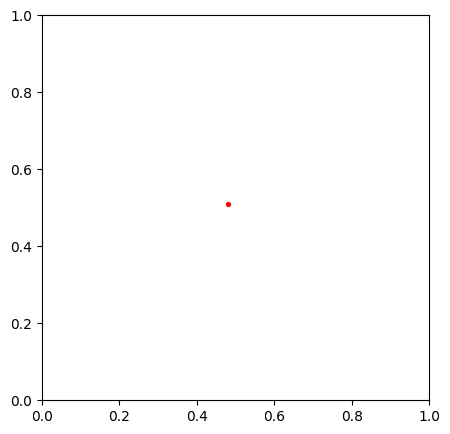

In [44]:
#run the line below, if you have not previously
pos_sim, vel_sim = simulate_wall(np.array([[0.5,0.5]]), np.array([[200.0,100.0]]), 8000, 0.0001)

fig, ax = plt.subplots(1,1,figsize=(5,5))
ax.clear()
vmin = 0
vmax = 1
ax.set_xlim(0,1)
ax.set_ylim(0,1)
markersize = 2 * 0.005 * ax.get_window_extent().width  / (vmax-vmin) * 72./fig.dpi
red, = ax.plot([], [], 'o', color='red', markersize=markersize)

def animate(i):
    xred, yred = pos_sim[i][:,0], pos_sim[i][:,1]
    red.set_data(xred, yred)
    return [red]


ani = animation.FuncAnimation(fig, animate, frames=500, interval=50, blit=True)
HTML(ani.to_jshtml())

<h3> Interparticle Collisions </h3>

Now let's write code that handles interparticle collisions. The ideal gas molecules don't interact with one another except for very brief collisions, in which they exchange energy and momentum with each other or with their thermal environment. For an ideal gas, all interparticle collisions will be elastic collsions.



### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.3.3</span>

For practical implementation, in each simulation step, we need to track which pair of particles collide. We will perform an elastic collision between two particles when they get closer than a distance of one diamter. Thus, in order to detect a collision, first we have to calculate the center of mass distances between each particles.

For bookkeeping indices, we give `n_particles` indices `0,1,...,n_particles-1`.

Given position vectors `position` of shape `[n_particles, 2]` and an array of indices corresponding to the particle pairs `idx_pair` of shape `[n_pair, 2]`, where each row is `[index_particle1, index_particle2]`, write a function that computes an array of shape `[n_pair]`, which is a pairwise distance of particles between every index pair of particles.  

For a given random `position` and `idx_pair` arrays below, report the resulting `distance_pairs` for the `0`, `23`, `234`, and `444`th entries.

In [ ]:
#>>>PROBLEM: P4.3.3

# helper function that calculates distance between particles of given index pair
def compute_distance_pairs(position, idx_pair):
    delta_x = #Your code goes here
    delta_y = #Your code goes here
    distances = #np.sqrt(delta_x**2 + delta_y**2)
    return distances


#-----------------------------------------------------
# CHECK YOUR RESULT

np.random.seed(0x98a09fe)
n_particles = 50 #number of particles
pos_initial = np.random.rand(n_particles, 2)
indices = np.arange(0,n_particles,1)
idx_pair = np.array(list(itertools.combinations(indices,2)))
print(compute_distance_pairs(pos_initial, idx_pair)[[0,23,234,444]])

In [45]:
#>>>SOLUTION: P4.3.3

# helper function that calculates distance between particles of given index pair
def compute_distance_pairs(position, idx_pair):
    delta_x = position[:,0][idx_pair][:,0] - position[:,0][idx_pair][:,1]
    delta_y = position[:,1][idx_pair][:,0] - position[:,1][idx_pair][:,1]
    distances = np.sqrt(delta_x**2 + delta_y**2)
    return distances


#-----------------------------------------------------
# CHECK YOUR RESULT

np.random.seed(0x98a09fe)
n_particles = 50 #number of particles
pos_initial = np.random.rand(n_particles, 2)
indices = np.arange(0,n_particles,1)
idx_pair = np.array(list(itertools.combinations(indices,2)))
print(compute_distance_pairs(pos_initial, idx_pair)[[0,23,234,444]])

[0.30366182 0.72319803 0.44839845 0.43339836]


<div style="border:1.5px; border-style:solid; padding: 0.5em; border-color: #90409C; color: #90409C;">

**SOLUTION:**

<pre>

</pre>
        
**EXPLANATION:**
    

  
    
</div>


### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.3.4</span>

Now, given a distance pair array for a given array of index pairs, we need to calculate which pairs actually collide, meaning they satisfy the condition that the center of mass distance between a pair of particles is smaller than `2*particle_radius`.

Write a simple function that takes `distance_pairs` as an input, and returns the array of indices of `idx_pairs` corresponding to pairs that collide. Hint: this should really just use a `np.where()` function!

To check your answer, use the same random array of particles that you previously defined, the code for which is again included below. **Enter indices of pairs that collide, as a list**

In [ ]:
#>>>PROBLEM: P4.3.4

def which_pair_collides(distance_pairs):
    #Your code goes here
    pass


#-----------------------------------------------------
# CHECK YOUR RESULT

np.random.seed(0x98a09fe)
n_particles = 50 #number of particles
pos_initial = np.random.rand(n_particles, 2)
indices = np.arange(0,n_particles,1)
idx_pair = np.array(list(itertools.combinations(indices,2)))

particle_radius = 0.01
distance_pairs = compute_distance_pairs(pos_initial, idx_pair)
which_pair_collides(distance_pairs)

In [46]:
#>>>SOLUTION: P4.3.4

def which_pair_collides(distance_pairs):
    return np.where(distance_pairs < 2*particle_radius)[0]

#-----------------------------------------------------
# CHECK YOUR RESULT

np.random.seed(0x98a09fe)
n_particles = 50 #number of particles
pos_initial = np.random.rand(n_particles, 2)
indices = np.arange(0,n_particles,1)
idx_pair = np.array(list(itertools.combinations(indices,2)))

particle_radius = 0.01
distance_pairs = compute_distance_pairs(pos_initial, idx_pair)
which_pair_collides(distance_pairs)

array([194, 610, 772])

<div style="border:1.5px; border-style:solid; padding: 0.5em; border-color: #90409C; color: #90409C;">

**SOLUTION:**

<pre>

</pre>
        
**EXPLANATION:**
    

  
    
</div>


<h3>Elastic Collsion of Particles</h3>


<p align="center">
<img alt="unit circle wave decomposition" src="https://upload.wikimedia.org/wikipedia/commons/2/2c/Elastischer_sto%C3%9F_2D.gif" width="600"/>
</p>

>source: https://commons.wikimedia.org/wiki/File:Animation_zum_Verst%C3%A4ndnis_der_Fourierentwicklung.gif<br>
>attribution: PZim, CC BY-SA 3.0 <https://creativecommons.org/licenses/by-sa/3.0>, via Wikimedia Commons

    
When two particles get closer 2 times the radius of the particle, we should perform elastic collision of particles.

In an elastic collision (conservation of energy + momentum + angular momentum, although in this case we neglect angular momentum), one can show

$$\vec{v}_1^{\text{new}} = \vec{v}_1 - \frac{(\vec{v}_1 - \vec{v}_2) \cdot (\vec{r}_1 - \vec{r}_2)}{|\vec{r}_1 - \vec{r}_2|^2} (\vec{r}_1 - \vec{r}_2)$$
$$\vec{v}_2^{\text{new}} = \vec{v}_2 - \frac{(\vec{v}_2 - \vec{v}_1) \cdot (\vec{r}_2 - \vec{r}_1)}{|\vec{r}_1 - \vec{r}_2|^2} (\vec{r}_2 - \vec{r}_1)$$

You can read more about it in $\href{https://en.wikipedia.org/wiki/Elastic_collision}{\text{Wikipedia}}$ or any intro to mechanics class textbook.



### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.3.5</span>

After a collision event, what is the final velocity of each of the two spheres?

Complete the code for `pair_collsion` below, which takes `pos_1i`, `pos_2i`, `vel_1i` and `vel_2i` as inputs representing the position and velocity vectors of particles, and returns the velocity vectors after the collsion with four sides of the wall.

In [ ]:
#>>>PROBLEM: P4.3.5

def pair_collision(pos_1i, pos_2i, vel_1i, vel_2i):
    vel_1f = 0 #YOUR CODE HERE
    vel_2f = 0 #YOUR CODE HERE
    return vel_1f, vel_2f


#-----------------------------------------------------
# CHECK YOUR RESULT

# Sample initial positions (x, y) and velocities (vx, vy) of two particles
pos_1i = np.array([[0.5, 0.5],
                   [0.8, 0.8]])
pos_2i = np.array([[0.7, 0.6],
                   [0.4, 0.4]])

vel_1i = np.array([[0.1, 0.1],
                   [-0.1, -0.1]])
vel_2i = np.array([[-0.1, 0.1],
                   [0.1, -0.1]])


# Apply the pair_collision function to the sample data
vel_1f, vel_2f = pair_collision(pos_1i, pos_2i, vel_1i, vel_2i)

# Print the updated velocities after collision handling
print("Initial Velocities:")
print("Particle 1:", vel_1i)
print("Particle 2:", vel_2i)

print("\nUpdated Velocities after Collision Handling:")
print("Particle 1:", vel_1f)
print("Particle 2:", vel_2f)

In [47]:
#>>>SOLUTION: P4.3.5

def pair_collision(pos_1i, pos_2i, vel_1i, vel_2i):
    vel_1f = vel_1i - (np.sum( (pos_1i-pos_2i) * (vel_1i-vel_2i),axis=1)/np.sum((pos_1i-pos_2i)**2, axis=1)).T @ (pos_1i - pos_2i)
    vel_2f = vel_2i - (np.sum( (pos_1i-pos_2i) * (vel_1i-vel_2i),axis=1)/np.sum((pos_1i-pos_2i)**2, axis=1)).T @ (pos_2i - pos_1i)
    return vel_1f, vel_2f


#-----------------------------------------------------
# CHECK YOUR RESULT

# Sample initial positions (x, y) and velocities (vx, vy) of two particles
pos_1i = np.array([[0.5, 0.5],
                   [0.8, 0.8]])
pos_2i = np.array([[0.7, 0.6],
                   [0.4, 0.4]])

vel_1i = np.array([[0.1, 0.1],
                   [-0.1, -0.1]])
vel_2i = np.array([[-0.1, 0.1],
                   [0.1, -0.1]])


# Apply the pair_collision function to the sample data
vel_1f, vel_2f = pair_collision(pos_1i, pos_2i, vel_1i, vel_2i)

# Print the updated velocities after collision handling
print("Initial Velocities:")
print("Particle 1:", vel_1i)
print("Particle 2:", vel_2i)

print("\nUpdated Velocities after Collision Handling:")
print("Particle 1:", vel_1f)
print("Particle 2:", vel_2f)

Initial Velocities:
Particle 1: [[ 0.1  0.1]
 [-0.1 -0.1]]
Particle 2: [[-0.1  0.1]
 [ 0.1 -0.1]]

Updated Velocities after Collision Handling:
Particle 1: [[ 0.04  0.12]
 [-0.16 -0.08]]
Particle 2: [[-0.04  0.08]
 [ 0.16 -0.12]]


<div style="border:1.5px; border-style:solid; padding: 0.5em; border-color: #90409C; color: #90409C;">

**SOLUTION:**

<pre>

</pre>
        
**EXPLANATION:**
    

  
    
</div>


### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.3.6</span>

Let's edit the `simulate` function we coded earlier to incorporate all particle-wise collisions.

The `idx_pair` variable keeps index pairs of every possible pair of particles.

We will handle pairwise collision as the first action in each loop, and wall collision afterwards.

Complete the function!

In [48]:
#>>>PROBLEM: P4.3.6

def simulate(pos, vel, time_steps, dt):

    nparticles = pos.shape[0]
    indices = np.arange(0,n_particles,1)
    idx_pair = np.array(list(itertools.combinations(indices,2)))

    pos_simulated = np.zeros((time_steps, n_particles, 2))
    vel_simulated = np.zeros((time_steps, n_particles, 2))

    pos_simulated[0] = pos
    vel_simulated[0] = vel

    #update the position and velocity based on particle collisions
    #and wall collisions
    for i in range(1,time_steps):
        #Your code here

    return pos_simulated, vel_simulated

IndentationError: expected an indented block after 'for' statement on line 17 (692559086.py, line 20)

In [49]:
#>>>SOLUTION: P4.3.6

def simulate(pos, vel, time_steps, dt):

    nparticles = pos.shape[0]
    indices = np.arange(0,n_particles,1)
    idx_pair = np.array(list(itertools.combinations(indices,2)))

    pos_simulated = np.zeros((time_steps, n_particles, 2))
    vel_simulated = np.zeros((time_steps, n_particles, 2))

    pos_simulated[0] = pos
    vel_simulated[0] = vel

    #update the position and velocity based on particle collisions
    #and wall collisions
    for i in range(1,time_steps):

        collision_idx = which_pair_collides(compute_distance_pairs(pos, idx_pair))
        v1f, v2f = pair_collision(pos[idx_pair[collision_idx][:,0]], pos[idx_pair[collision_idx][:,1]],
                                  vel[idx_pair[collision_idx][:,0]], vel[idx_pair[collision_idx][:,1]])

        vel[idx_pair[collision_idx][:,0]] = v1f
        vel[idx_pair[collision_idx][:,1]] = v2f

        vel = wall_collision(pos, vel)

        pos = pos + vel * dt

        vel_simulated[i] = vel
        pos_simulated[i] = pos

    return pos_simulated, vel_simulated

<div style="border:1.5px; border-style:solid; padding: 0.5em; border-color: #90409C; color: #90409C;">

**SOLUTION:**

<pre>

</pre>
        
**EXPLANATION:**
    

  
    
</div>


<h3>Setting Parameters of our Simulation</h3>

Now let's run this thing! It might take a few moments to complete...

In [50]:
np.random.seed(4150032420)
n_particles = 65 #number of particles
particle_radius = 0.003 #radius of individual particles
L = 1 #side length of the box

pos_initial = np.random.rand(n_particles, 2) #inditial position of particles
# Setting up the initial 2D velocities of particles
vel_initial = np.zeros((n_particles,2))
vel_initial[pos_initial[:,0]>=L/2, 0] = -100
vel_initial[pos_initial[:,0]<L/2, 0] = 100
vel_initial[:, 1] = 0

pos_sim, vel_sim = simulate(pos_initial, vel_initial, 5000, 0.0001)

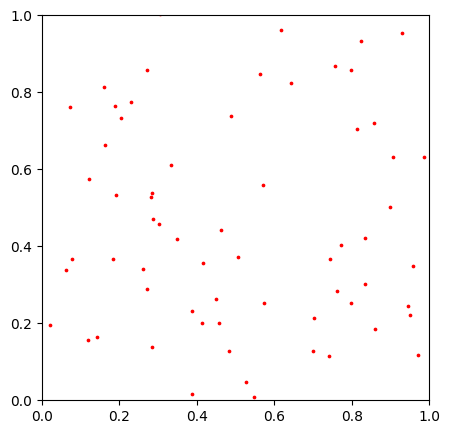

In [51]:
fig, ax = plt.subplots(1,1,figsize=(5,5))
ax.clear()
vmin = 0
vmax = 1
ax.set_xlim(0,1)
ax.set_ylim(0,1)
markersize = 2 * particle_radius * ax.get_window_extent().width  / (vmax-vmin) * 72./fig.dpi
red, = ax.plot([], [], 'o', color='red', markersize=markersize)

def animate(i):
    xred, yred = pos_sim[i][:,0], pos_sim[i][:,1]
    red.set_data(xred, yred)
    return [red]



ani = animation.FuncAnimation(fig, animate, frames=500, interval=50, blit=True)
HTML(ani.to_jshtml())

### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.3.7</span>

Now, let's run the simulation until it reaches thermal equilibrium, and then compare the final velocity distribution of the particles to the Maxwell-Boltzmann distribution in 2 Dimensions:

Using <a href="https://en.wikipedia.org/wiki/Equipartition_theorem" target="_blank">Equipartition Theorem</a> in thermal equilibrium, each degree of freedom contributes $\frac{1}{2}k_B T$ to the average energy.

In 2-dimensional space, there are 2 degrees of freedom:

* $d \times \frac{1}{2}k_B T = 2 \times \frac{1}{2}k_B T = KE_{avg} = \frac{1}{2}m\bar{v^2} \implies \boxed{\frac{m}{kT} = \frac{2}{\bar{v^2}}}$

* $\boxed{f(v) = \frac{m}{kT} v \exp\left(-\frac{m}{kT}\frac{v^2}{2} \right)}$


Let's set the initial velocity to $100 m/s$, and use this fact to to calculate the value of $\frac{m}{kT}$. Complete the function `maxwell_boltzmann(v)` with this information.

In [ ]:
#>>>PROBLEM: P4.3.7

def maxwell_boltzmann(v):
    fv = #YOUR CODE HERE
    return fv


#-----------------------------------------------------
# CHECK YOUR RESULT

v_test = np.linspace(0, 2000, 1001)
print(maxwell_boltzmann(v_test)[np.where(v_test==100)[0]])

In [52]:
#>>>SOLUTION: P4.3.7

def maxwell_boltzmann(v):
    a = 2./100.**2
    fv = a*v*np.exp(-a*v**2 / 2)
    return fv


#-----------------------------------------------------
# CHECK YOUR RESULT

v_test = np.linspace(0, 2000, 1001)
print(maxwell_boltzmann(v_test)[np.where(v_test==100)[0]])

[0.00735759]


<div style="border:1.5px; border-style:solid; padding: 0.5em; border-color: #90409C; color: #90409C;">

**SOLUTION:**

<pre>

</pre>
        
**EXPLANATION:**
    

  
    
</div>


<h3>Comparing Simulation to Theory</h3>

We will now run a simulation and compare to the predicted distribution. Let's increase the number of particles in order to populate a histogram more completely. This might take some time...

In [53]:
#let's increase the number of particles significantly

np.random.seed(673720454)
n_particles = 400
particle_radius = 0.0002

pos_initial = np.random.rand(n_particles, 2)
vel_initial = np.zeros((n_particles,2))
thetas = np.random.rand(n_particles)* 2 * np.pi
vel_initial[:, 0] = np.cos(thetas) * 100
vel_initial[:, 1] = np.sin(thetas) * 100

# This can take a while to run...
pos_sim, vel_sim = simulate(pos_initial, vel_initial, 200000, 0.0000008)

(0.0, 300.0)

<Figure size 640x480 with 0 Axes>

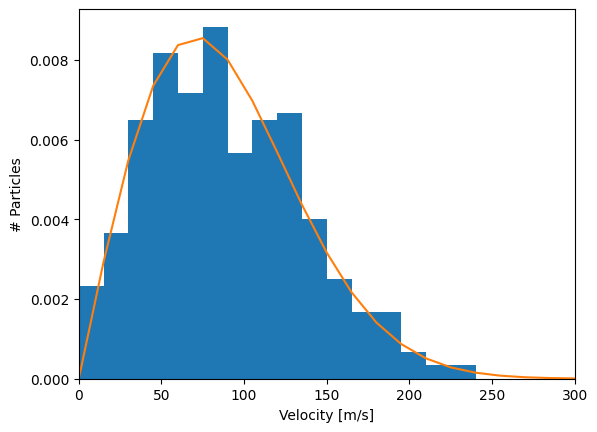

In [55]:
bins = np.linspace(0,300,21)
plt.clf()
plt.figure()
plt.hist(np.sqrt(np.sum(vel_sim[-1]**2, axis=1)), bins=bins, density=True)
plt.plot(bins,maxwell_boltzmann(bins))
plt.xlabel('Velocity [m/s]')
plt.ylabel('# Particles')
plt.xlim(0,300)
#plt.show()

With some simple simulation, we were able to obtain Maxwell-Boltzmann distribution! Now let's turn that into an animation and see how the distribution evolves from the initial uniform velocity.

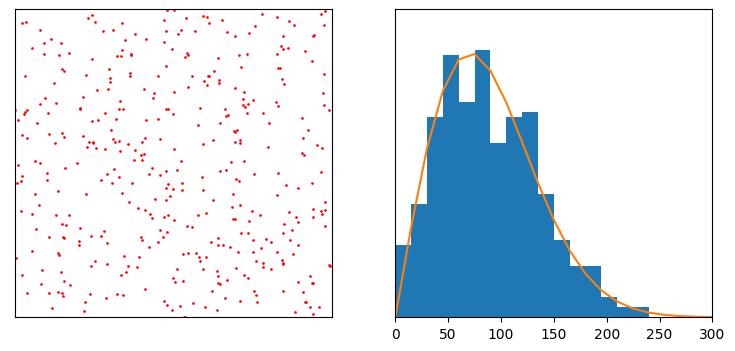

In [57]:
fig, axes = plt.subplots(1, 2, figsize=(9,4))
axes[0].clear()
vmin = 0
vmax = 1
axes[0].set_xlim(0,1)
axes[0].set_ylim(0,1)
axes[0].get_xaxis().set_visible(False)
axes[0].get_yaxis().set_visible(False)
markersize = 10*2 * particle_radius * axes[0].get_window_extent().width  / (vmax-vmin) * 72./fig.dpi
red, = axes[0].plot([], [], 'o', color='red', markersize=markersize)
n, bins, patches = axes[1].hist(np.sqrt(np.sum(vel_sim[0]**2, axis=1)), bins=bins, density=True)
axes[1].plot(bins,maxwell_boltzmann(bins))
axes[1].set_xlim(0,300)
axes[1].set_ylim(0,0.01)
axes[1].get_yaxis().set_visible(False)

def animate(i):
    xred, yred = pos_sim[i][:,0], pos_sim[i][:,1]
    red.set_data(xred, yred)
    hist, _ = np.histogram(np.sqrt(np.sum(vel_sim[i]**2, axis=1)), bins=bins, density=True)
    for i, patch in enumerate(patches):
        patch.set_height(hist[i])
    return [red]

from itertools import chain
ani_hist = animation.FuncAnimation(fig, animate, frames=range(0,200000,500), interval=50, blit=True)
#list(chain(range(100),range(100, 39500, 100), range(39500, 40000)))

HTML(ani_hist.to_jshtml())

<h3>Going Beyond: Other Energy Scales</h3>

Does this simulation hold for all energy scales (i.e., initial velocity distributions)? Is energy always conserved (try making plots of total energy vs. time)? Consider if there any changes that you need to make when simulating a system with starting velocity of 500m/s or 1000m/s.

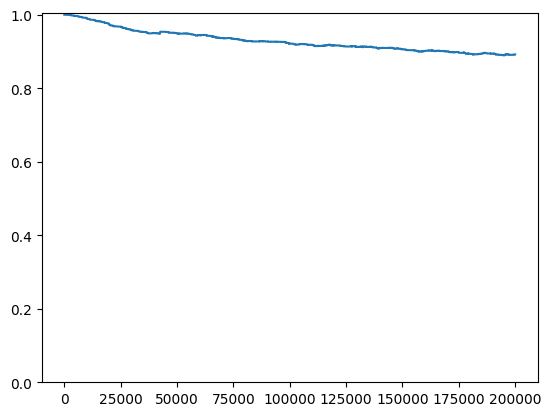

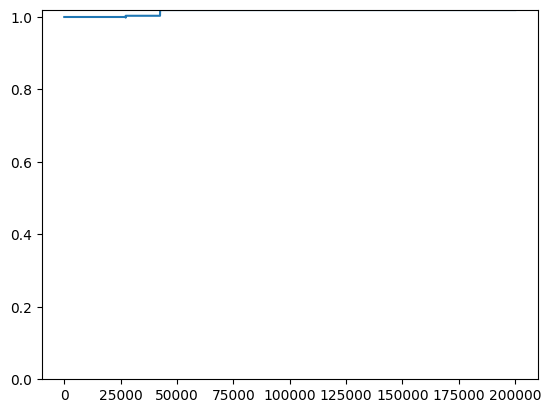

In [58]:
#Here is an exploration of the question above. Energy is not constant!
#This is more apparent at higher initial speeds. Why?

#get the particle velocities at each time step
def v_timestepi(vel_array,i):
  return np.sqrt(np.sum(vel_array[i]**2,axis=1))

def get_velocity_time(vel_sim):
  avg_vel = []
  for i in range(len(vel_sim)):
    avg_vel.append(np.average(v_timestepi(vel_sim,i)))
  return np.array(avg_vel)/avg_vel[0]

def get_energy_time(vel_sim):
  energy_tot = []
  for i in range(len(vel_sim)):
    energy_tot.append(np.sum(v_timestepi(vel_sim,i)**2.))
  return np.array(energy_tot)/energy_tot[0]

velocity_time = get_velocity_time(vel_sim)
plt.plot(range(len(velocity_time)),velocity_time)
plt.ylim(0,)
plt.show()


energy_time = get_energy_time(vel_sim)
plt.plot(range(len(energy_time)),energy_time)
plt.ylim(0,)
plt.show()

#these are not constant!

<!--start-block-->
<a name='section_4_4'></a>
<hr style="height: 1px;">

## <h2 style="border:1px; border-style:solid; padding: 0.25em; color: #FFFFFF; background-color: #90409C">P4.4 Ideal Gas Law from Molecular Simulation</h2>

| [Top](#section_4_0) | [Previous Section](#section_4_3) | [Problems](#problems_4_4) |

<h3>Overview</h3>

Now with the setup we just completed, we will derive ideal gas relations.

The ideal gas law combines Gay-Lussac's law, Avogadro's law, and Boyle's law. We will confirm each of them through our molecular simulation and, in order to do that, we will compute macroscopic quantities such as pressure based on the microscopic components.

In real life, it's easier to keep the pressure constant to atmospheric presure, and vary the volume. However, in simulations, it's easier to keep the volume constant and measure the pressure change.

Therefore, for the case of Avogadro's law, we will show a version where we keep the volume constant and vary the number of particles, while observing the pressure.  

<h3>Gay-Lussac's Law</h3>

Firstly, we will check Gay-Lussac's law, which states that the pressure exerted by a given mass and constant volume of an ideal gas on the sides of its container is directly proportional to its absolute temperature. In practice, we will keep the volume of the box and the number of particles in the simulation constant, and we will show that $P \propto T$. We then fit the data witha linear model to obtain the slope, $\frac{P}{T} = A$ where $A$ is some constant.


The pressure $P$ can be calculated as the following:

$$P = \frac{F}{4L}$$

where $F$ is the force and $L$ is the side length of the box. We just need to compute the imparted force. Noting that $F = \Delta p / \Delta t$, we can compute the force as follows:

 * We track particles that hit the walls of the box and compute the change of momentum $\Delta p_i = m \Delta v_i$ given to the box at each time step.
 * The mass of the individual particles is kept constant.
 * The force is then $F = \sum_i |\Delta p_i| / \Delta t$ where $\Delta t$ is the length of time we sum the momentum change, after reaching thermal equilibrium

Therefore,

 $$P = \frac{m \sum |\Delta v_i|}{4L \Delta t}$$

The temperate and the average temperature has relation by equipartition theorem as described above.

$$d \times \frac{1}{2}k_B T = 2 \times \frac{1}{2}k_B T = k_B T = KE_{avg} = \frac{1}{2}m\bar{v^2} $$

Therefore we get

 $$T = \frac{m \bar{v^2}}{2 k_B}$$

where $\bar{v^2}$ is the initial velocity magnitude that we set as a constant for every particle.

Now, we see that both $P$ and $T$ have dependence on $m$, the particle mass. Since they cancel out for $P/T$, we will in practice calculate $P/m$ and $T/m$

<a name='problems_4_4'></a>     

| [Top](#section_4_0) | [Restart Section](#section_4_4) |


### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.4.1</span>

Write a function named `compute_delta_v` that takes 2 inputs: a velocity before collsion with the wall, `vel_i`, the velocity after collision, `vel_f`, and then returns the sum of the change of magnitude of all the collsions with the wall:

$$\sum_i |\Delta v_i|$$



In [ ]:
#>>>PROBLEM: P4.4.1

def compute_delta_v(vel_i, vel_f):
    #Your Code Here
    pass

In [59]:
#>>>SOLUTION: P4.4.1

def compute_delta_v(vel_i, vel_f):
    return np.sum(np.abs(vel_f - vel_i))

<div style="border:1.5px; border-style:solid; padding: 0.5em; border-color: #90409C; color: #90409C;">

**SOLUTION:**

<pre>

</pre>
        
**EXPLANATION:**
    

  
    
</div>


<h3>Augmenting the Simulation</h3>

Let's add this to our simulation code to also keep track of $\Delta v$

In [60]:
def simulate(pos, vel, time_steps, dt):


    nparticles = pos.shape[0]
    indices = np.arange(0,n_particles,1)
    idx_pair = np.array(list(itertools.combinations(indices,2)))

    pos_simulated = np.zeros((time_steps, n_particles, 2))
    vel_simulated = np.zeros((time_steps, n_particles, 2))
    dv = np.zeros((time_steps))

    pos_simulated[0] = pos
    vel_simulated[0] = vel
    dv[0] = 0

    for i in range(1,time_steps):

        collision_idx = which_pair_collides(compute_distance_pairs(pos, idx_pair))
        v1f, v2f = pair_collision(pos[idx_pair[collision_idx][:,0]], pos[idx_pair[collision_idx][:,1]],
                                  vel[idx_pair[collision_idx][:,0]], vel[idx_pair[collision_idx][:,1]])

        vel[idx_pair[collision_idx][:,0]] = v1f
        vel[idx_pair[collision_idx][:,1]] = v2f

        vel_before = vel.copy()
        vel = wall_collision(pos, vel)
        delta_v = compute_delta_v(vel_before, vel)
        dv[i] = delta_v

        pos = pos + vel * dt


        vel_simulated[i] = vel
        pos_simulated[i] = pos

    return pos_simulated, vel_simulated, dv



### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.4.2</span>

Now write a function named `compute_pressure` that takes 3 inputs: an array `dv_sim` which keeps track of the $\Delta v$ in each simulation step, `npoints` the number of time steps we want to intergrate from the simulation end, and `dt` the length of the time step, then returns the pressure using the formula given in the overview section:

$$P/m = \frac{ \sum |\Delta v_i|}{4L \Delta t}$$


Use the function in the loop provided above, and enter the pressure for the case when `v_magnitude` is equal to $300 m/s$

In [ ]:
#>>>PROBLEM: P4.4.2

def compute_pressure(dv_sim, npoints, dt):
    pass #YOUR CODE HERE

npoints = 2000
simulation_steps = 40000
dt = 0.0000008
pressure_list = []
v_list = np.array([0, 300, 350, 400, 450])
for v_magnitude in v_list:
    vel_initial = np.zeros((n_particles,2))
    np.random.seed(673720454)
    thetas = np.random.rand(n_particles)* 2 * np.pi
    vel_initial[:, 0] = np.cos(thetas) * v_magnitude
    vel_initial[:, 1] = np.sin(thetas) * v_magnitude
    pos_sim, vel_sim, dv_sim = simulate(pos_initial, vel_initial, simulation_steps, dt)
    pressure = compute_pressure(dv_sim, npoints, dt)
    pressure_list.append(pressure)

print(pressure_list[1])

In [74]:
#>>>SOLUTION: P4.4.2

def compute_pressure(dv_sim, npoints, dt):
    return np.sum(dv_sim[-npoints:])/(4 * (npoints*dt) )

npoints = 2000
simulation_steps = 40000
dt = 0.0000008
pressure_list = []
v_list = np.array([0, 300, 350, 400, 450])
for v_magnitude in v_list:
    vel_initial = np.zeros((n_particles,2))
    np.random.seed(673720454)
    thetas = np.random.rand(n_particles)* 2 * np.pi
    vel_initial[:, 0] = np.cos(thetas) * v_magnitude
    vel_initial[:, 1] = np.sin(thetas) * v_magnitude
    pos_sim, vel_sim, dv_sim = simulate(pos_initial, vel_initial, simulation_steps, dt)
    pressure = compute_pressure(dv_sim, npoints, dt)
    pressure_list.append(pressure)

print(pressure_list[1])

21644062.384607874


<div style="border:1.5px; border-style:solid; padding: 0.5em; border-color: #90409C; color: #90409C;">

**SOLUTION:**

<pre>

</pre>
        
**EXPLANATION:**
    

  
    
</div>


### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.4.3</span>


Write a function named `compute_temperature` that takes 1 input: an array `v_list` of magnitudes of velocities, and returns an array of temperatures using the formula given in the overview section.

 $$T/m = \frac{\bar{v^2}}{2 k_B}$$

Use the function in the loop provided above, and enter the temperature for the case when `v_magnitude` is equal to $300 m/s$. Now we are able to make a plot of P vs. T, try it out!

In [ ]:
#>>>PROBLEM: P4.4.3

def compute_temperature(vel):
    pass #YOUR CODE HERE

[0.00000000e+00 3.26086957e+27 4.43840580e+27 5.79710145e+27
 7.33695652e+27] [0.0, 21644062.384607874, 28643407.233183574, 36556359.47228582, 50764089.1613159]


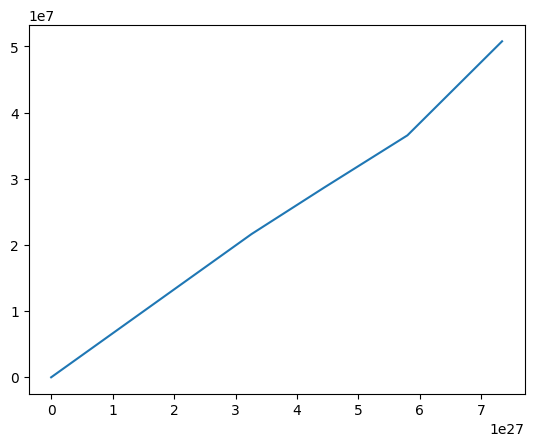

In [76]:
#>>>SOLUTION: P4.4.3

def compute_temperature(vel):
    return vel**2/(2*1.38e-23)

T = compute_temperature(v_list)
print(T,pressure_list)
plt.plot(T, pressure_list)
plt.show()

<div style="border:1.5px; border-style:solid; padding: 0.5em; border-color: #90409C; color: #90409C;">

**SOLUTION:**

<pre>

</pre>
        
**EXPLANATION:**
    

  
    
</div>


### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.4.4</span>


Let's use lmfit to get the slope of $P$ vs $T$ graph. Firstly, scale the $x$ axis by $10^{-27}$ and the $y$ axis by $10^{-7}$.

Then, enter the slope of the fit after fitting to three significant digits.

In [ ]:
#>>>PROBLEM: P4.4.4

import lmfit
from lmfit import Model,Parameters #https://lmfit.github.io/lmfit-py/parameters.html
                                   #https://lmfit.github.io/lmfit-py/model.html#lmfit.model.Model

#YOUR CODE HERE

[[Model]]
    Model(linear_model)
[[Fit Statistics]]
    # fitting method   = leastsq
    # function evals   = 7
    # data points      = 5
    # variables        = 2
    chi-square         = 0.32820802
    reduced chi-square = 0.10940267
    Akaike info crit   = -9.61772790
    Bayesian info crit = -10.3988521
    R-squared          = 0.97680644
[[Variables]]
    a:  0.67405640 +/- 0.02972022 (4.41%) (init = 2.7)
    b: -0.05640999 +/- 0.14423958 (255.70%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(a, b) = -0.859


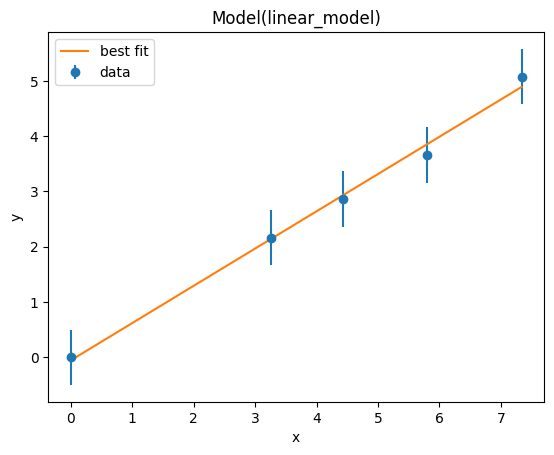

In [77]:
#>>>SOLUTION: P4.4.4

from lmfit.models import Model

def linear_model(x, a, b):
    return a*x+b

lmod = Model(linear_model)
lmod.set_param_hint(name = 'a', value = 2.7)
lmod.set_param_hint(name = 'b', value = 0)
result = lmod.fit(np.array(pressure_list)*1e-7, x = T*1e-27, weights = (2)*np.ones(len(pressure_list)))
print(result.fit_report())
result.plot_fit()
plt.show()

<div style="border:1.5px; border-style:solid; padding: 0.5em; border-color: #90409C; color: #90409C;">

**SOLUTION:**

<pre>

</pre>
        
**EXPLANATION:**
    

  
    
</div>


### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.4.5</span>


As a next step, let's confirm the pressure version of Avogadro's law. In other words, let's show that with temperature and volume fixed, $P \propto N$, where $N$ is the number of particles.

Enter the value of the pressure when the number of particles is equal to 450

In [81]:
#>>>SOLUTION: P4.4.5

npoints = 20
simulation_steps = 40000
dt = 0.0000008
nparticles_list = [300,350, 400,450, 500]
pressure_list = []
v_magnitude= 500
for n_particles in nparticles_list:
    vel_initial = np.zeros((n_particles,2))
    np.random.seed(673720454)
    pos_initial = np.random.rand(n_particles, 2)
    thetas = np.random.rand(n_particles)* 2 * np.pi
    vel_initial[:, 0] = np.cos(thetas) * v_magnitude
    vel_initial[:, 1] = np.sin(thetas) * v_magnitude
    pos_sim, vel_sim, dv_sim = simulate(pos_initial, vel_initial, simulation_steps, dt)
    pressure = compute_pressure(dv_sim, npoints, dt)
    pressure_list.append(pressure)

print(pressure_list[3])

14379959.718318924


ValueError: x and y must have same first dimension, but have shapes (5,) and (4,)

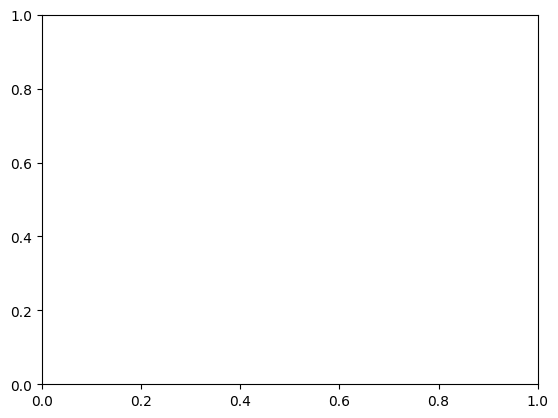

In [80]:
plt.plot(nparticles_list, pressure_list)

<div style="border:1.5px; border-style:solid; padding: 0.5em; border-color: #90409C; color: #90409C;">

**SOLUTION:**

<pre>

</pre>
        
**EXPLANATION:**
    

  
    
</div>


### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.4.6</span>


Finally, let's check Boyle's Law. We have to show that when we fix the number of particles and temperature, $P \propto \frac{1}{V}$. In order to do that, we should be able to vary the volume of the simulation by changing the side length variable `L` in the code.

Firstly, edit the code for the function `wall_collision` so that you can vary the wall side length `L`. Then, enter the pressure value when the area of the container is equal to $4$. Finally draw the plot of the plot $P$ vs $\frac{1}{V}$

In [ ]:
#>>>PROBLEM: P4.4.6

L = 1
def wall_collision(pos, vel):
    #collsion with the right wall
    vel[pos[:, 0] > L, 0] = # Your code goes here.

    #collision with the left wall
    vel[pos[:, 0] < 0, 0] = # Your code goes here.

    #collision with the top wall
    vel[pos[:, 1] > L, 1] = # Your code goes here.

    #collsion with the bottom wall
    vel[pos[:, 1] < 0, 1] = # Your code goes here.
    return vel

In [66]:
#>>>SOLUTION: P4.4.6

L = 1
def wall_collision(pos, vel):
    # Your code goes here.
    #collsion with the right wall
    vel[pos[:, 0] > L, 0] = -np.abs(vel[pos[:, 0] > L, 0])

    #collision with the left wall
    vel[pos[:, 0] < 0, 0] = np.abs(vel[pos[:, 0] < 0, 0])

    #collision with the top wall
    vel[pos[:, 1] > L, 1] = -np.abs(vel[pos[:, 1] > L, 1])

    #collsion with the bottom wall
    vel[pos[:, 1] < 0, 1] = np.abs(vel[pos[:, 1] < 0, 1])
    return vel

<div style="border:1.5px; border-style:solid; padding: 0.5em; border-color: #90409C; color: #90409C;">

**SOLUTION:**

<pre>

</pre>
        
**EXPLANATION:**
    

  
    
</div>


In [79]:
npoints = 2000
simulation_steps = 40000
dt = 0.0000008
pressure_list = []
L_list = np.array([1,1.5,2,2.5,3])
n_particles = 400
np.random.seed(673720454)
pos_initial = np.random.rand(n_particles, 2)
for L in L_list:
    vel_initial = np.zeros((n_particles,2))
    np.random.seed(673720454)
    thetas = np.random.rand(n_particles)* 2 * np.pi
    vel_initial[:, 0] = np.cos(thetas) * v_magnitude
    vel_initial[:, 1] = np.sin(thetas) * v_magnitude
    pos_sim, vel_sim, dv_sim = simulate(pos_initial, vel_initial, simulation_steps, dt)
    pressure = compute_pressure(dv_sim, npoints, dt)
    pressure_list.append(pressure)
    #print(pressure)
print(pressure_list[2])

KeyboardInterrupt: 

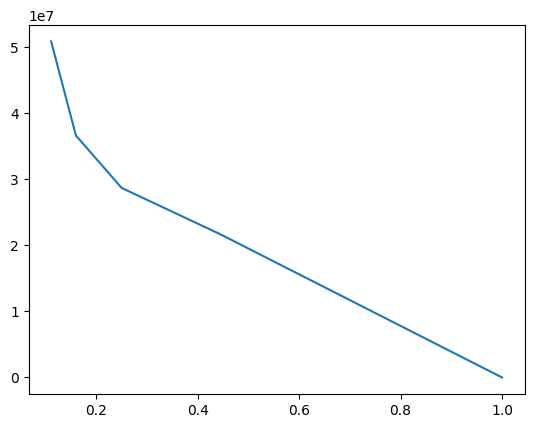

In [75]:
plt.plot(1/(L_list**2), pressure_list)

### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.4.7</span>

We've confimred that:
* with $N$ and $V$ fixed, $P \propto T$
* with $V$ and $T$ fixed, $P \propto N$
* with $T$ and $N$ fixed, $P \propto \frac{1}{V}$

Thus, combining them all, we get that $\frac{PV}{NT} = C$ where $C$ is a constant.
Rearranging this equation, $\frac{P}{T} = C\frac{N}{V}$

In Problem 4.2.4, by fitting we got the value of $\frac{P}{T}$ with 400 particles and box of side length $1$. Using this fit value, compute the value of $C$.

Hint. With 400 particles and the volume(area) = $1\times 1 = 1$, the slope in problem 4.2.4 is $400C$

Is $C$ close to the value $k_B$ as we expect? Rearranging the equation, we get $PV = Nk_B T$, the ideal gas relation in two dimensions.


<div style="border:1.5px; border-style:solid; padding: 0.5em; border-color: #90409C; color: #90409C;">

**SOLUTION:**

<pre>

</pre>
        
**EXPLANATION:**
    

  
    
</div>


<!--start-block-->
<a name='section_4_5'></a>
<hr style="height: 1px;">

## <h2 style="border:1px; border-style:solid; padding: 0.25em; color: #FFFFFF; background-color: #90409C">P4.5 Galaxy Rotation Curves

| [Top](#section_4_0) | [Previous Section](#section_4_4) | [Problems](#problems_4_4) |

<h3>Overview</h3>

In this problem, we are going to make a simulation of a galaxy, from this simuilation, we will then compute rotation curves. The we will modify the simulation, adding two populations, visible matter, and dark matter. Then we will see how we can emulate the behavior of rotation curves.

Lastly, we will investigate how to bring this to scale.

In [1]:
import imageio
from PIL import Image
from IPython.display import Image

import numpy as np
import matplotlib.pyplot as plt
import numpy as np
import csv

#Units
Gc=39.478 #AU^3/yr^2/Msun
re=1.0#AU
ve=2*np.pi*re#2pir/yr
Gmod=Gc/re**2

<h3> Basic Setup </h3>

Lets start by seeing how a galaxy forms. To do that, lets randomly place in a uniform distribution, and then evolve it. For the first part of this problem, we will use the parallelized part of the star evolution, as oppose to the tree structure.  


### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.4.1</span>

In the code below, add the force equations and computation of $\Delta r^2_{ij}=\Delta x_{ij}^2 + \Delta y_{ij}^2 + \epsilon^2$ matrix that builds on the $\Delta r$ computation. Be sure to add the softening term $\epsilon$


In [ ]:
###Visualiztion code
def makePlot(nbody,coords,ax,fig,images,ymin=-2,ymax=2,xmin=-2,xmax=2):
    # plot and show learning process
    plt.cla()
    ax.set_xlabel('x(AU)', fontsize=24)
    ax.set_ylabel('y(AU)', fontsize=24)
    ax.set_ylim(ymin,ymax)
    ax.set_xlim(xmin,xmax)
    for body in range(nbody):
        ax.plot(np.flip(coords[body][:,0]),np.flip(coords[body][:,1]), 'o-',color = '#d2eeff',markevery=10000, markerfacecolor = '#0077BE',lw=2)
    fig.canvas.draw()       # draw the canvas, cache the renderer
    image = np.frombuffer(fig.canvas.tostring_rgb(), dtype='uint8')
    image  = image.reshape(fig.canvas.get_width_height()[::-1] + (3,))
    images.append(image)


def animate(coords,iN=2,ymin=-10,ymax=10,xmin=-10,xmax=10,stepsize=50):
    images = []
    fig, ax = plt.subplots(figsize=(12,7))
    for step in range(len(coords[0])-110):
        if step % stepsize == 0:
            makePlot(iN,coords[:,step:step+100],ax,fig,images,ymin=ymin,ymax=ymax,xmin=xmin,xmax=xmax)
    return images

#this function computes the force and potential energy of the system
def forcefunction_base(iR,iMass,iSofen):
    xpos=iR[:,0:1]
    ypos=iR[:,1:2]
    dx = xpos.T - xpos
    dy = ypos.T - ypos
    dr2  = #Add your own code, be sure to add softening
    dr1        = dr2**(-0.5)
    dr2[dr2>0] = dr2[dr2>0]**(-1.5)
    ax   = #Add your own code
    ay   = #Add your own code
    a = np.hstack((ax,ay))
    pot = #Add your own code to compute the potential Energy
    return a,pot

forcefunction = forcefunction_base

class AllStars:
    def __init__(self,iX,iV,iM,ibase=True,isoften=1e-2):
        self.rpos = iX
        self.v    = iV
        self.mass = iM
        self.n    = len(iX)
        self.posh   = np.array([])
        self.velh   = np.array([])
        self.enh    = np.array([])
        self.nsteps = 0
        self.soften = isoften
        self.base   = ibase

    def force(self): #take in arrays of everything
        if self.base:
            self.a,self.pot = forcefunction_base(self.rpos,self.mass,self.soften)
        else:
            self.a,self.pot = forcefunction(self.rpos,self.mass,self.soften)
            
    def firststep(self,dt):
        self.v    = self.v   +0.5*dt*self.a
        self.rpos = self.rpos+dt*self.v

    def step(self,dt):
        self.v    = self.v   +dt*self.a
        self.rpos = self.rpos+dt*self.v

    def store(self):
        lXs = self.rpos
        self.posh = np.append(self.posh,lXs)
        lVs = self.v
        self.velh = np.append(self.velh,lVs)
        lV2 = np.reshape((lVs[:,0]**2+lVs[:,1]**2),(self.n,1))
        lEn = 0.5*self.mass*lV2 + self.mass *self.pot
        self.enh  = np.append(self.enh,lEn)

    def points(self):
        return self.rpos

    def history(self):
        return np.reshape(self.posh,(self.nsteps,self.n,2))

    def velhistory(self):
        return np.reshape(self.velh,(self.nsteps,self.n,2))

    def enhistory(self):
        return np.reshape(self.enh,(self.nsteps,self.n))

    def allsteps(self,insteps=5000,dt=0.001):
        nsteps=insteps
        self.nsteps+=nsteps
        self.force()
        self.firststep(dt)
        for t in range(nsteps):
            self.force()
            self.step(dt)
            self.store()
        return self.points()

In [3]:
###Visualiztion code
def makePlot(nbody,coords,ax,fig,images,ymin=-2,ymax=2,xmin=-2,xmax=2):
    # plot and show learning process
    plt.cla()
    ax.set_xlabel('x(AU)', fontsize=24)
    ax.set_ylabel('y(AU)', fontsize=24)
    ax.set_ylim(ymin,ymax)
    ax.set_xlim(xmin,xmax)
    for body in range(nbody):
        ax.plot(np.flip(coords[body][:,0]),np.flip(coords[body][:,1]), 'o-',color = '#d2eeff',markevery=10000, markerfacecolor = '#0077BE',lw=2)
    fig.canvas.draw()       # draw the canvas, cache the renderer
    image = np.frombuffer(fig.canvas.tostring_rgb(), dtype='uint8')
    image  = image.reshape(fig.canvas.get_width_height()[::-1] + (3,))
    images.append(image)


def animate(coords,iN=2,ymin=-10,ymax=10,xmin=-10,xmax=10,stepsize=50):
    images = []
    fig, ax = plt.subplots(figsize=(12,7))
    for step in range(len(coords[0])-110):
        if step % stepsize == 0:
            makePlot(iN,coords[:,step:step+100],ax,fig,images,ymin=ymin,ymax=ymax,xmin=xmin,xmax=xmax)
    return images

#this function computes the force and potential energy of the system
def forcefunction_base(iR,iMass,iSoften):
    xpos=iR[:,0:1]
    ypos=iR[:,1:2]
    dx = xpos.T - xpos
    dy = ypos.T - ypos
    dr2  = dx**2 + dy**2 + iSoften**2
    dr1  = dr2**(-0.5)
    dr2[dr2>0] = dr2[dr2>0]**(-1.5)
    ax   = Gmod * (dx*dr2) @ iMass
    ay   = Gmod * (dy*dr2) @ iMass
    a = np.hstack((ax,ay))
    pot = -1.*Gmod * dr1 @ iMass
    return a,pot

forcefunction = forcefunction_base

class AllStars:
    def __init__(self,iX,iV,iM,ibase=True,isoften=1e-2):
        self.rpos = iX
        self.v    = iV
        self.mass = iM
        self.n    = len(iX)
        self.posh   = np.array([])
        self.velh   = np.array([])
        self.enh    = np.array([])
        self.nsteps = 0
        self.soften = isoften
        self.base   = ibase

    def force(self): #take in arrays of everything
        if self.base:
            self.a,self.pot = forcefunction_base(self.rpos,self.mass,self.soften)
        else:
            self.a,self.pot = forcefunction(self.rpos,self.mass,self.soften)

    def firststep(self,dt):
        self.v    = self.v   +0.5*dt*self.a
        self.rpos = self.rpos+dt*self.v

    def step(self,dt):
        self.v    = self.v   +dt*self.a
        self.rpos = self.rpos+dt*self.v

    def store(self):
        lXs = self.rpos
        self.posh = np.append(self.posh,lXs)
        lVs = self.v
        self.velh = np.append(self.velh,lVs)
        lV2 = np.reshape((lVs[:,0]**2+lVs[:,1]**2),(self.n,1))
        lEn = 0.5*self.mass*lV2 + self.mass *self.pot
        self.enh  = np.append(self.enh,lEn)

    def points(self):
        return self.rpos

    def history(self):
        return np.reshape(self.posh,(self.nsteps,self.n,2))

    def velhistory(self):
        return np.reshape(self.velh,(self.nsteps,self.n,2))

    def enhistory(self):
        return np.reshape(self.enh,(self.nsteps,self.n))

    def allsteps(self,insteps=5000,dt=0.001):
        nsteps=insteps
        self.nsteps+=nsteps
        self.force()
        self.firststep(dt)
        for t in range(nsteps):
            if t % 5000 == 0:
                print("Step:",t,"/",insteps)
            self.force()
            self.step(dt)
            self.store()
        return self.points()

<div style="border:1.5px; border-style:solid; padding: 0.5em; border-color: #90409C; color: #90409C;">

**SOLUTION:**

<pre>

        dr2  = dx**2 + dy**2 + self.soften**2
        ax   = Gmod * (dx*dr2) @ self.mass
        ay   = Gmod * (dy*dr2) @ self.mass
        pot = Gmod * dr1 @ self.mass

</pre>
        
**EXPLANATION:**
    
This is just applying Gravitational laws to the code. Importantly the softening term is needed to avoid divergences. We will take a relatively large softening term as we go forward in this situation.
  
    
</div>


### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.4.2</span>

Now lets check if this code makes sense, perform a 2-body simulation for a circular orbit of a binary star eaching having a solar mass and radius of 1 Au. Note that
$$\frac{\mu v^2}{r } = \frac{GM_{1}M_{2}}{r^2}$$

What is the timestep the simulation breaks down?

In [ ]:
np.random.seed(1234)
nStar=2
X = np.zeros((nStar, 2))
V = np.zeros((nStar, 2))
M = np.ones((nStar,1))
vcircle =
X[0,0] =  1
X[1,0] = -1
V[0,1] =  vcircle*0.5
V[1,1] = -vcircle*0.5

allStar = AllStars(X,V,M)
Xout=allStar.allsteps(insteps=1000,dt=1e-3) ###dt > 0.33 it stops working

tracks=allStar.history()
tracks=np.swapaxes(tracks,0,1)
images=animate(tracks,iN=nStar,xmin=-2,xmax=2,ymin=-2,ymax=2,stepsize=100)
imageio.mimsave('./orbit_n_v2_v1.gif', images, fps=10)
Image(open('orbit_n_v2_v1.gif','rb').read())


SyntaxError: invalid syntax (<ipython-input-5-b753f923947e>, line 6)

Step: 0 / 3000


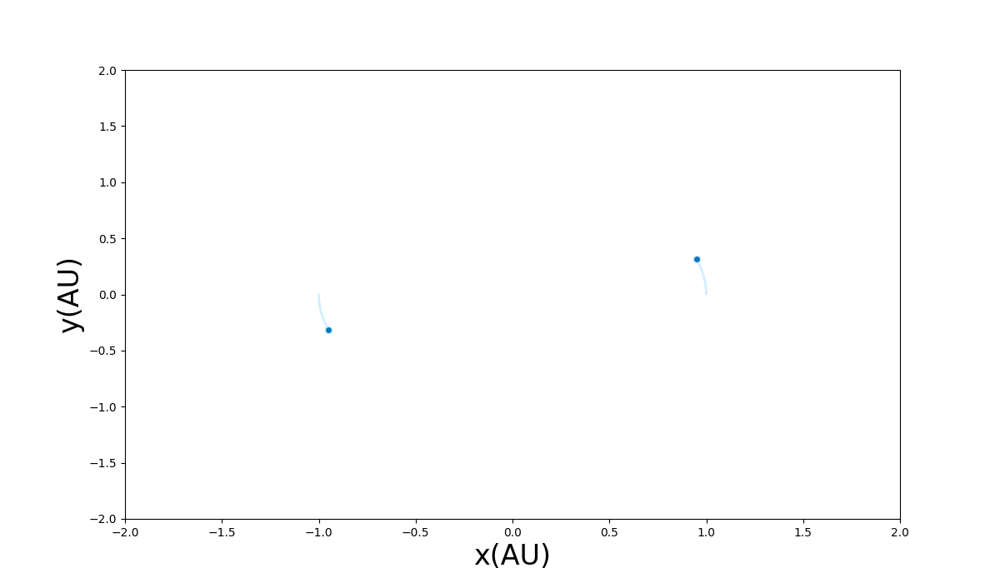

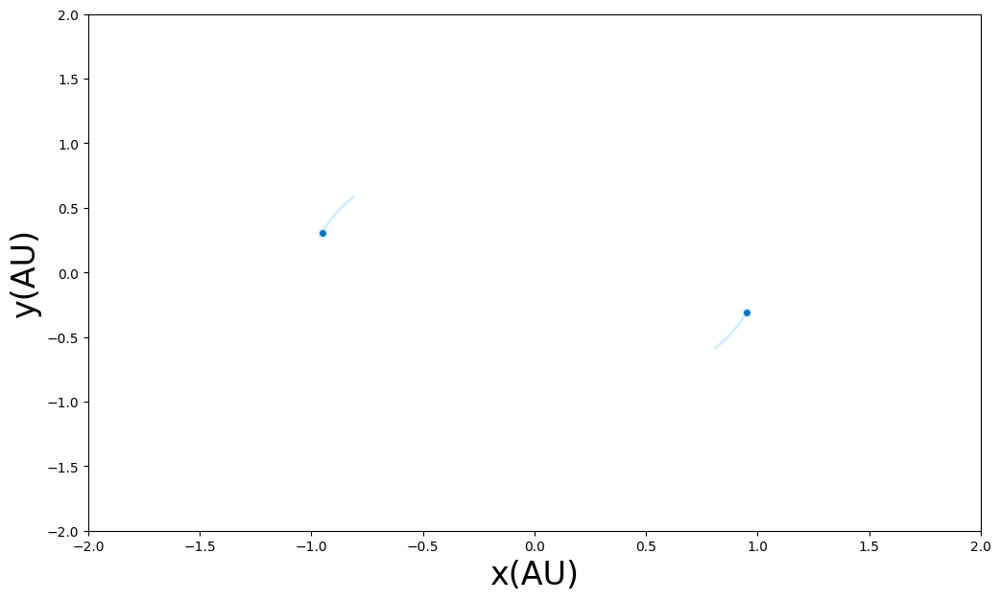

In [4]:
import matplotlib.image as mpimg

np.random.seed(1234)
nStar=2
X = np.zeros((nStar, 2))
V = np.zeros((nStar, 2))
M = np.ones((nStar,1))
vcircle = np.sqrt(Gmod)
X[0,0] =  1
X[1,0] = -1
V[0,1] =  vcircle*0.5
V[1,1] = -vcircle*0.5

allStar = AllStars(X,V,M)
Xout=allStar.allsteps(insteps=3000,dt=1e-3) ###dt > 0.33 it stops working

tracks=allStar.history()
tracks=np.swapaxes(tracks,0,1)
images=animate(tracks,iN=nStar,xmin=-2,xmax=2,ymin=-2,ymax=2,stepsize=100)
imageio.mimsave('./orbit_n_v2_v1.gif', images, fps=10)
Image(open('orbit_n_v2_v1.gif','rb').read())
#plt.imshow(mpimg.imread("orbit_n_v2_v1.gif"))


<div style="border:1.5px; border-style:solid; padding: 0.5em; border-color: #90409C; color: #90409C;">

**SOLUTION:**

<pre>
vcircle = np.sqrt(Gmod)
dt=0.33

</pre>
        
**EXPLANATION:**
    
$$v_{circular} = \sqrt{\frac{G(M_{1}+M_{2})}{r}} = \sqrt{G}$$

when $r=2$ AU and $M=1$ solar mass

We find that dt > 0.33 (approximately) the orbits start to breakdown and stop working.
    
</div>


### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.4.3</span>

Now, we want to make a realistic galaxy simulation so that we can study how galaxies form and ultimately make some rotation curves. Let start by randomly sampling stars in a rectangular grid of with 20000 x 20000 astronomical units; for starters we can sample 50 stars and evolve it. The typical density of stars at the center of a galaxy is about 1 star per 500 astronomical units, which equates to about 20 times the density we consider here. Run this simulation in two modes, first run this in a mode where you can make sure the motion makes sense (1000 steps or so), choose an appropriate time step and soften parameter. Then, when you are happy run this for a long period (1 Million years or so), this long simulation will allow us to understand galaxy evolution.  

To see how the galaxy is formed randomly sample the stars and evolve it.  

What happens to the center of mass of the system?
a) it stays the same
b) it changes

What happens to the angular momentum of the star system?
a) it stays the same
b) it changes


In [ ]:
#First we will sample 3000 stars in 2D space with 2D velocity
nStar=50
np.random.seed(1234)
X = #Your code here
V = np.zeros((nStar, 2))
M = np.ones((nStar,1))

allStar = AllStars(X,V,M,isoften=1e2)
Xout=allStar.allsteps(insteps=100,dt=1.)
tracks=allStar.history()
tracks=np.swapaxes(tracks,0,1)
images=animate(tracks,iN=nStar,xmin=-4e4,xmax=4e4,ymin=-4e4,ymax=4e4,stepsize=100)
imageio.mimsave('./orbit_n.gif', images, fps=10)
Image(open('orbit_n.gif','rb').read())


Step: 0 / 40000
Step: 5000 / 40000
Step: 10000 / 40000
Step: 15000 / 40000
Step: 20000 / 40000
Step: 25000 / 40000
Step: 30000 / 40000
Step: 35000 / 40000


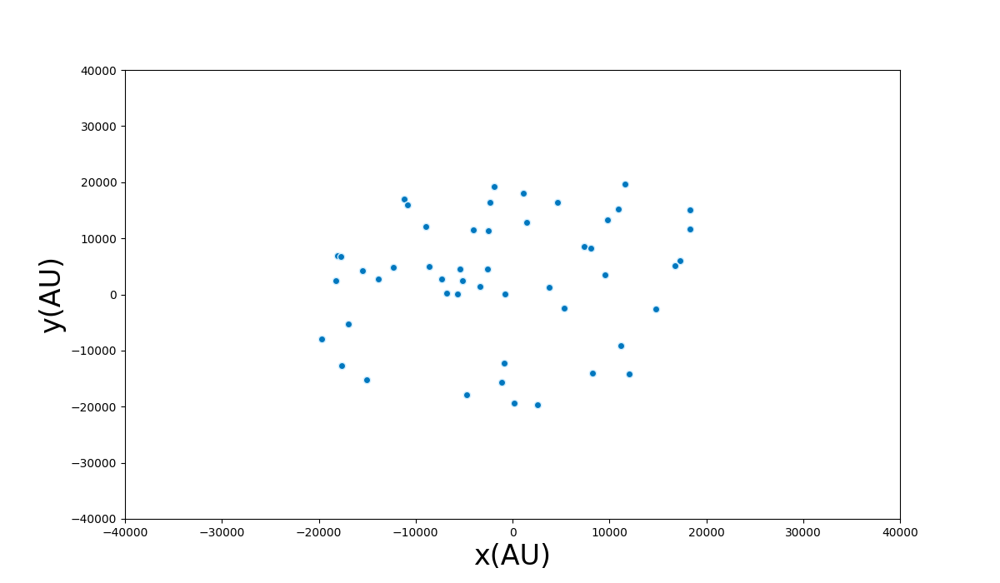

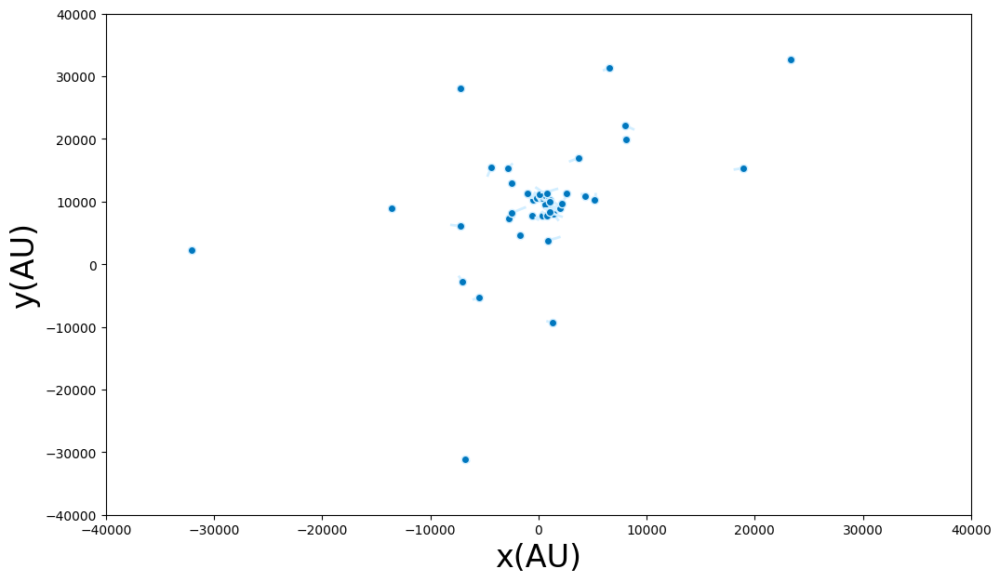

In [5]:
#First we will sample 3000 stars in 2D space with 2D velocity
nStar=50
np.random.seed(1234)
X = np.random.uniform(-1,1,(nStar, 2)) * 2e4
V = np.zeros((nStar, 2))
M = np.ones((nStar,1))

allStar = AllStars(X,V,M,isoften=1e3)
Xout=allStar.allsteps(insteps=40000,dt=25.)
tracks=allStar.history()
animtracks=np.swapaxes(tracks,0,1)
images=animate(animtracks,iN=nStar,xmin=-4e4,xmax=4e4,ymin=-4e4,ymax=4e4,stepsize=100)
imageio.mimsave('./orbit_n.gif', images, fps=10)
Image(open('orbit_n.gif','rb').read())


<div style="border:1.5px; border-style:solid; padding: 0.5em; border-color: #90409C; color: #90409C;">

**SOLUTION:**

<pre>

Stays the same

</pre>
        
**EXPLANATION:**
    
While the simulation might not conserve these variables, the laws of physics says they shold be conserved. Looking at the simulation by eye, it seems they are conserved.   
    
</div>


### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.4.4</span>
First lets run some common sense checks of our simulation.

First lets run some common sense checks of our simulation. We want to know:

A) What is the max change in the center of mass of the total system?  

B) What is the change in velocity of the system?

C) What is the change in the angular of moentum of the total system from beginning to end?

D) What is the change in energy?

Determine the order-of-magnitude answers to the above questions (for instance, `2.567e-10` would be expressed as `1e-10`, `7.567e-10` would be expressed as `1e-9`, and `2.567` would be expressed as `1e1`, etc.). Report your results as a list of numbers.

In [6]:
def centerOfMass(iVec):
    #center=#compute center of mass
    return center

def angMomentun(iR,iV):
    center=centerOfMass(iR)
    shift=#Shift coordinates by center
    ang=## Your code here for angular mometnum
    return np.sum(ang,axis=0)

comX0=centerOfMass(tracks[0])
comX1=centerOfMass(tracks[-1])
print("com0",comX0,"

veltracks=allStar.velhistory()
vcomX0=centerOfMass(veltracks[0])
vcomX1=centerOfMass(veltracks[-1])
print("vel com0",vcomX0,"vel com1",vcomX1)

LcomX0=angMomentun(tracks[0],veltracks[0])
LcomX1=angMomentun(tracks[-1],veltracks[-1])
print("L com0",LcomX0,"L com1",LcomX1)

enhist=allStar.enhistory()
enhisttot=#Sum over the particle axis to get the total energy
print("E tot",enhisttot[0],"E final",enhisttot[-1])


##Now some fun plots
def shiftCOM(iR):
    center=centerOfMass(iR)
    shift=iR
    for pVal in range(iR.shape[1]):
        shift[:,pVal] -= center
    return shift

def angMomentumTime(iR,iV):
    center=centerOfMass(iR)
    shift=shiftCOM(iR)
    ang=shift[:,:,0]*iV[:,:,1]-shift[:,:,1]*iV[:,:,0]
    return np.sum(ang,axis=1)

Ltime=angMomentumTime(tracks,veltracks)
plt.plot(Ltime)
plt.xlabel("iter")
plt.ylabel("L")
plt.show()

plt.plot(enhisttot)
plt.xlabel("iter")
plt.ylabel("E")
plt.show()



SyntaxError: unterminated string literal (detected at line 13) (3007325196.py, line 13)

In [7]:
def centerOfMass(iVec):
    center=np.mean(iVec,axis=0)
    return center

def angMomentun(iR,iV):
    center=centerOfMass(iR)
    shift=iR-center
    ang=shift[:,0]*iV[:,1]-shift[:,1]*iV[:,0]
    return np.sum(ang,axis=0)


tracks=allStar.history()
comX0=centerOfMass(tracks[0])
comX1=centerOfMass(tracks[-1])
print("com0",comX0,"com1",comX1)
print("delta_com", np.sqrt(np.sum((comX1 - comX0)**2.)))
print()

veltracks=allStar.velhistory()
vcomX0=centerOfMass(veltracks[0])
vcomX1=centerOfMass(veltracks[-1])
print("vel com0",vcomX0,"vel com1",vcomX1)
print("delta_com_vel", np.sqrt(np.sum((vcomX1 - vcomX0)**2.)))
print()

LcomX0=angMomentun(tracks[0],veltracks[0])
LcomX1=angMomentun(tracks[-1],veltracks[-1])
print("L com0",LcomX0,"L com1",LcomX1)
print("delta_com_L", abs(LcomX1 - LcomX0))
print()

enhist=allStar.enhistory()
enhisttot=np.sum(enhist,axis=1)
E0 = enhisttot[0]
E1 = enhisttot[-1]
print("E tot",E0,"E final",E1)
print("delta_E", abs(E1 - E0))

com0 [-1316.64945744  2785.68208774] com1 [-1316.64945744  2785.68208774]
delta_com 4.817957511304839e-10

vel com0 [ 9.75781955e-21 -2.03287907e-22] vel com1 [-9.59232693e-16  1.53210777e-16]
delta_com_vel 9.714008876807162e-16

L com0 2.609024107869118e-15 L com1 2.6693669497035444e-10
delta_com_L 2.6693408594624657e-10

E tot -9.089333065480314 E final -12.29267672299963
delta_E 3.2033436575193157


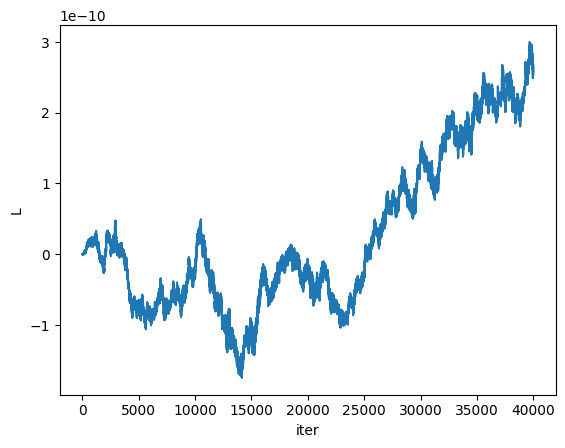

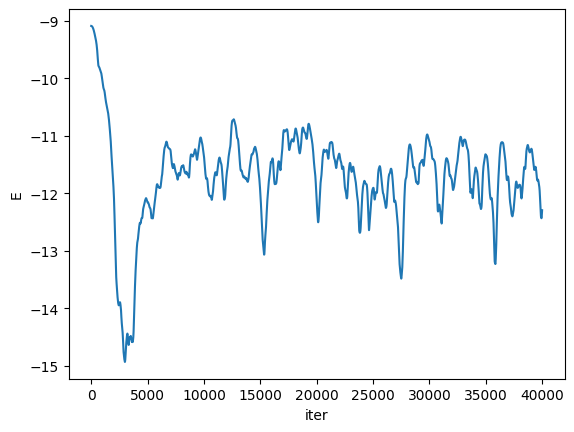

In [8]:
#PHIL-HERE-2

##Now some fun plots
def centerOfMassTime(iVec):
    center=np.sum(iVec,axis=1)/iVec.shape[1]
    return center

def shiftCOM(iR):
    center=centerOfMassTime(iR)
    shift=iR
    for pVal in range(iR.shape[1]):
        shift[:,pVal] -= center
    return shift

def angMomentumTime(iR,iV):
    shift=shiftCOM(iR)
    ang=shift[:,:,0]*iV[:,:,1]-shift[:,:,1]*iV[:,:,0]
    return np.sum(ang,axis=1)


Ltime=angMomentumTime(tracks,veltracks)
plt.plot(Ltime)
plt.xlabel("iter")
plt.ylabel("L")
plt.show()

plt.plot(enhisttot)
plt.xlabel("iter")
plt.ylabel("E")
plt.show()

<div style="border:1.5px; border-style:solid; padding: 0.5em; border-color: #90409C; color: #90409C;">

**SOLUTION:**

<pre>

[0,<1e-14,< 1e-6, < 5]

</pre>
        
**EXPLANATION:**
    
The reality is that all of these parameters should be zero, but alas our simulatino is just not good enough to account for this, so we have to bound the system with what we have.
    
</div>


### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.4.5</span>

Now that we have answered the basic questions, lets go ahead and try to come up with a more detailed analytic answer. Given our above simulation, write a script to show the average density before and after the simulation. Roughly what fraction of stars are > 10k AU before evolving. What fraction are  > 10k after at least 1 Million years of evolution.


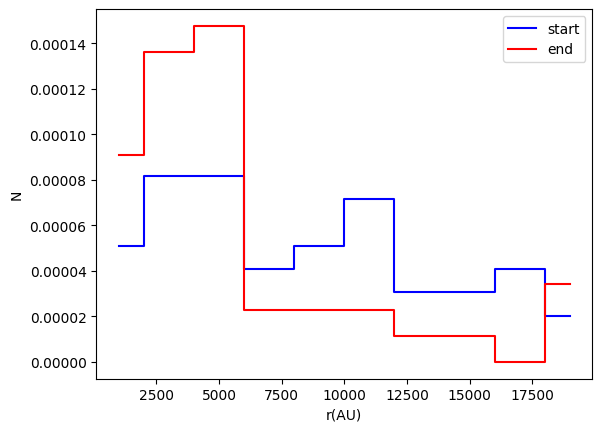

NameError: name 'iTracks' is not defined

In [9]:
def makeRadiusHist(iX):
    shift=shiftCOM(iX)
    evts,bin_edges=np.histogram(np.sqrt(shift[:,0]**2+shift[:,1]**2),bins=10,range=[0,2e4],density=True)
    bin_centers=0.5*(bin_edges[1:]+bin_edges[:-1])
    return bin_centers,evts

def plotRadius(iTracks):
    pX0,pY0 = makeRadiusHist(iTracks[0])
    plt.plot(pX0,pY0,drawstyle = 'steps-mid',label='start',c='blue')
    pX1,pY1 = makeRadiusHist(iTracks[-1])
    plt.plot(pX1,pY1,drawstyle = 'steps-mid',label='end',c='red')
    plt.legend()
    plt.xlabel("r(AU)")
    plt.ylabel("N")
    plt.show()

plotRadius(tracks)

#now density => each bin divide by r => rho=N/2pirdr
pX0,pY0 = makeRadiusHist(iTracks[0])
pX1,pY1 = makeRadiusHist(iTracks[-1])
plt.plot(pX0,pY0/pX0,drawstyle = 'steps-mid',label='start',c='blue')
plt.plot(pX1,pY1/pX1,drawstyle = 'steps-mid',label='end',c='red')
plt.legend()
plt.xlabel("r(AU)")
plt.ylabel("rho")
plt.show()

def fraction(iX,iR=50000):
    ## Your code here
    return frac

frc0=fraction(tracks[0])
frc1=fraction(tracks[-1])
print("Fraction:",frc0," Updated Fraction",frc1)


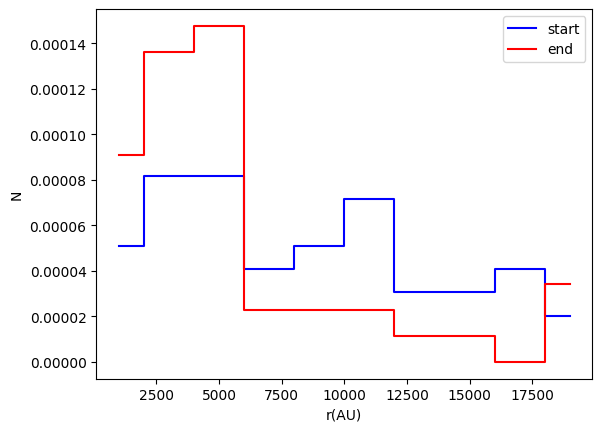

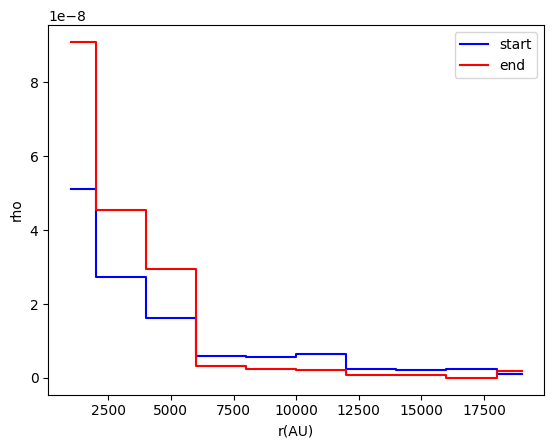

Fraction: 0.4  Updated Fraction 0.26


In [9]:
def makeRadiusHist(iX):
    shift=shiftCOM(iX)
    evts,bin_edges=np.histogram(np.sqrt(shift[:,0]**2+shift[:,1]**2),bins=10,range=[0,2e4],density=True)
    bin_centers=0.5*(bin_edges[1:]+bin_edges[:-1])
    return bin_centers,evts

def plotRadius(iTracks):
    pX0,pY0 = makeRadiusHist(iTracks[0])
    plt.plot(pX0,pY0,drawstyle = 'steps-mid',label='start',c='blue')
    pX1,pY1 = makeRadiusHist(iTracks[-1])
    plt.plot(pX1,pY1,drawstyle = 'steps-mid',label='end',c='red')
    plt.legend()
    plt.xlabel("r(AU)")
    plt.ylabel("N")
    plt.show()

plotRadius(tracks)

#now density => each bin divide by r => rho=N/2pirdr
pX0,pY0 = makeRadiusHist(tracks[0])
pX1,pY1 = makeRadiusHist(tracks[-1])
plt.plot(pX0,pY0/pX0,drawstyle = 'steps-mid',label='start',c='blue')
plt.plot(pX1,pY1/pX1,drawstyle = 'steps-mid',label='end',c='red')
plt.legend()
plt.xlabel("r(AU)")
plt.ylabel("rho")
plt.show()

def fraction(iX,iR=10000):
    tmp=np.ones(iX.shape[0])
    frac=len(tmp[np.sqrt(iX[:,0]**2+iX[:,1]**2) > iR])/len(tmp)
    return frac

frc0=fraction(tracks[0])
frc1=fraction(tracks[-1])
print("Fraction:",frc0," Updated Fraction",frc1)


<div style="border:1.5px; border-style:solid; padding: 0.5em; border-color: #90409C; color: #90409C;">

**SOLUTION:**

<pre>

> 50% (any number from 50-70%)

</pre>
        
**EXPLANATION:**
    
Many stars merge into the center. However, then they go back out, and we don't see much of a change in the distribution of stars. 
    
</div>


### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.4.6</span>

Now lets start to look at how the galaxy evolves. Plot the average radial velocity vs radius of the toy galaxy what is the velocity ratio of the inner 80% compared to the last 20%?

In [ ]:
def plotRvsV(iR,iV,iNbins=5): 
    #Sort data array in R
    sort = #get sorted indices
    #split data into nbins
    corrXsort = iR[sort]
    corrYsort = iV[sort]
    ncands=len(iV)//iNbins
    corrXsort = np.reshape(corrXsort,(ncands,iNbins))
    corrXmean = #compute Xsort mean in bins 
    corrXrms  = #compute Xsort std in bins

    corrYsort = np.reshape(corrYsort,(ncands,iNbins))
    corrYmean = #compute Ysort mean in bins 
    corrYrms  = #compute Ysort std in bins
    return corrXmean,corrYmean,corrXrms,corrYrms

##Now some fun plots
def shiftCOM(iR):
    center=#compute ceneter of mass
    shift=iR
    #shift it
    for pVal in range(iR.shape[0]):
        shift[pVal] -= center 
    return shift

def velCOM(iX,iV):
    #compute projected radial velocity (r x v)/|r| (note iX[:,0] is the first element of all particles)
    return vproj
    
def plotRotation(veltracks,tmptracks):
    shiftX=shiftCOM(tmptracks[0])
    velX=velCOM(shiftX,veltracks[0])
    pX0,pY0,pEX0,pEY0 = plotRvsV(np.sqrt(shiftX[:,0]**2+shiftX[:,1]**2),np.abs(velX))
    plt.errorbar(pX0,pY0,pEY0,pEX0,marker='v',linestyle='none',label='start',c='blue')
    shiftX=shiftCOM(tmptracks[-1])
    pX1,pY1,pEX1,pEY1 = plotRvsV(np.sqrt(shiftX[:,0]**2+shiftX[:,1]**2),np.abs(velX))
    plt.errorbar(pX1,pY1,pEY1,pEX1,marker='o',linestyle='none',label='end',c='red')
    plt.legend()
    plt.xlabel("R(AU)")
    plt.ylabel("V(AU/year)")
    plt.show()

tracks=allStar.history()
veltracks=allStar.velhistory()
plotRotation(veltracks,tracks)


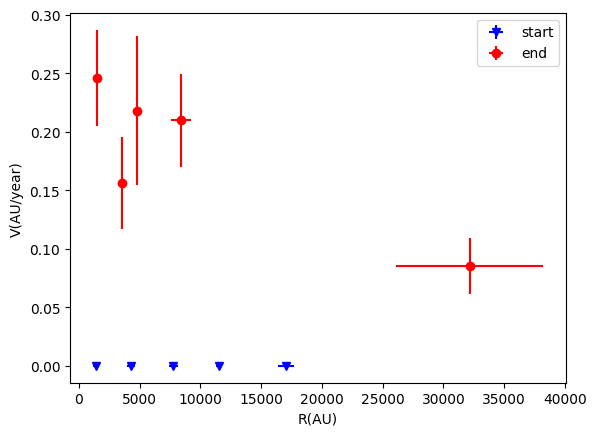

In [14]:
def plotRvsV(iR,iV,iNbins=5): 
    #Sort data
    sort = np.argsort(iR)
    #split data into nbins
    corrXsort = iR[sort]
    corrYsort = iV[sort]
    ncands=len(iV)//iNbins
    corrXsort = np.reshape(corrXsort,(iNbins,ncands))
    corrXmean = np.mean(corrXsort,axis=1)
    corrXrms  = np.std(corrXsort,axis=1)/np.sqrt(ncands)

    corrYsort = np.reshape(corrYsort,(iNbins,ncands))
    corrYmean = np.mean(corrYsort,axis=1)
    corrYrms  = np.std(corrYsort,axis=1)/np.sqrt(ncands)
    return corrXmean,corrYmean,corrXrms,corrYrms

##Now some fun plots
def shiftCOM(iR):
    center=np.mean(iR < 10000,axis=0)
    shift=iR
    for pVal in range(iR.shape[0]):
        shift[pVal] -= center 
    return shift

def velCOM(iX,iV):
    #(r x v)/|r|
    vproj=(iX[:,0]*iV[:,1]-iX[:,1]*iV[:,0])/(np.sqrt(iX[:,0]**2+iX[:,1]**2))
    return vproj
    
def plotRotation(veltracks,tmptracks):
    shiftX=shiftCOM(tmptracks[0])
    velX=velCOM(shiftX,veltracks[0])
    pX0,pY0,pEX0,pEY0 = plotRvsV(np.sqrt(shiftX[:,0]**2+shiftX[:,1]**2),np.abs(velX))
    plt.errorbar(pX0,pY0,pEY0,pEX0,marker='v',linestyle='none',label='start',c='blue')
    shiftX=shiftCOM(tmptracks[-1])
    velX=velCOM(shiftX,veltracks[-1])
    pX1,pY1,pEX1,pEY1 = plotRvsV(np.sqrt(shiftX[:,0]**2+shiftX[:,1]**2),np.abs(velX))
    plt.errorbar(pX1,pY1,pEY1,pEX1,marker='o',linestyle='none',label='end',c='red')
    plt.legend()
    plt.xlabel("R(AU)")
    plt.ylabel("V(AU/year)")
    plt.show()

tracks=allStar.history()
veltracks=allStar.velhistory()
plotRotation(veltracks,tracks)


### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.4.7</span>
We know that the discovery of flat rotation curves (flat radial velocity as a function of radius from the galaxy) led to an explanation for dark matter. What is the reason our simulation cannot produce this effect? 



<div style="border:1.5px; border-style:solid; padding: 0.5em; border-color: #90409C; color: #90409C;">

**SOLUTION:**

<pre>

We are lacking matter iteractions

</pre>
        
**EXPLANATION:**
    
Currently our simulation only has dark matter interactions, there are no other type of interactions. Its these other interactions that slow things down and allow us to have someo dynamics in the shape of the galaxy. 
    
</div>


### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.4.8</span>
Lets simulate a simplified matter galaxy (not dark matter). To do this we need to an insert a force that is not gravitational. What we will do is once the stars get close to each other, we negate the force on them. Namely 

$$
\forall \Delta_{ij} < \epsilon\\ \rightarrow F_{ij} = -F_{ij}^{Grav} = \frac{G m_{i}m_{j}}{|\vec{r}_{i}-\vec{r}_{j}|^3} \vec{r}_{i}-\vec{r}_{j}
$$

The idea is to envision the stars as elastic balls that scatter on each other, the aim here is to emulate a much stronger force that acts locally once the matter is close to each other. In reality this is done treaing the star as a fluid and running a simulation similar to the other probelms. 

Now modify the force and compare the rotation curve, what happens to the ratio of the velocity inner 90% of stars compared to the 10%?

In [ ]:
#this function computes the force and potential energy of the system
def forcefunction(iR,iMass,iSoften):
    xpos=iR[:,0:1]
    ypos=iR[:,1:2]
    dx = xpos.T - xpos
    dy = ypos.T - ypos
    dr2  = #Add your own code, be sure to add softening
    dr1  = dr2**(-0.5)
    dr2[dr2>0] = dr2[dr2>0]**(-1.5)
    dr2b = #selection on events dr2 < X
    dr2[dr2b] =#code to change forces
    ax   = #Add your own code
    ay   = #Add your own code
    a = np.hstack((ax,ay))
    pot = -1.*Gmod * dr1 @ iMass
    return a,pot

nStar=50
np.random.seed(1234)
X = np.random.uniform(-1,1,(nStar, 2)) * 2e4 
V = np.zeros((nStar, 2))
M = np.ones((nStar,1))

allIntStar = AllStars(X,V,M,isoften=1e3)
Xout=allIntStar.allsteps(insteps=40000,dt=25.)
tracks=allIntStar.history()
veltracks=allIntStar.velhistory()
plotRotation(veltracks,tracks)
plotRadius(tracks)
plt.show()

Step: 0 / 40000
Step: 5000 / 40000
Step: 10000 / 40000
Step: 15000 / 40000
Step: 20000 / 40000
Step: 25000 / 40000
Step: 30000 / 40000
Step: 35000 / 40000
Step: 0 / 40000
Step: 5000 / 40000
Step: 10000 / 40000
Step: 15000 / 40000
Step: 20000 / 40000
Step: 25000 / 40000
Step: 30000 / 40000
Step: 35000 / 40000


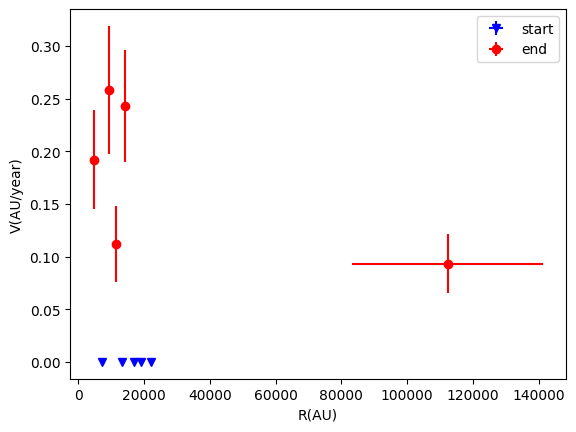

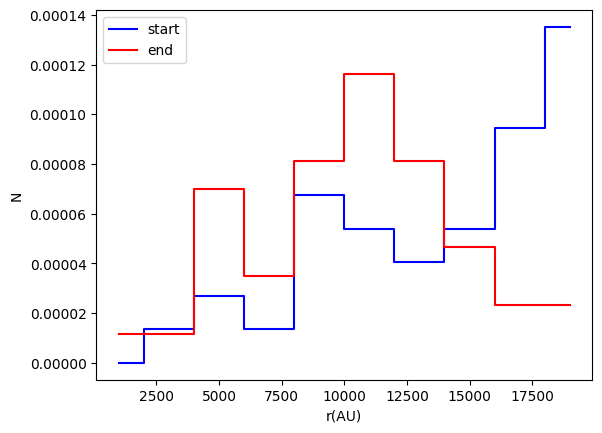

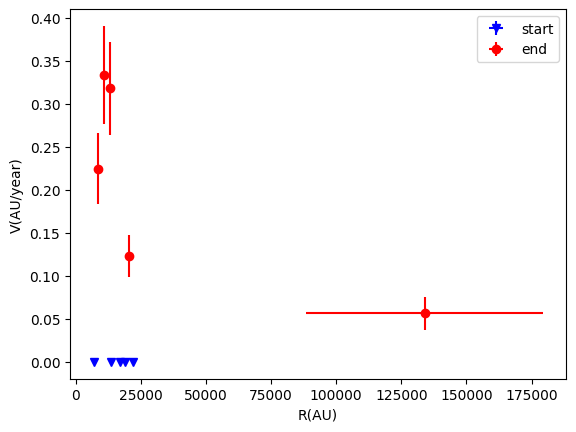

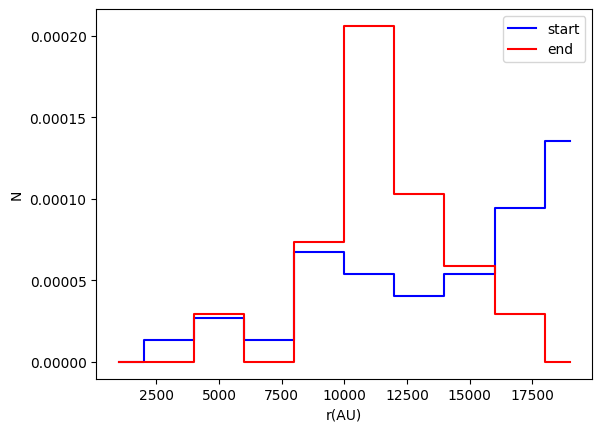

In [15]:
#this function computes the force and potential energy of the system
def forcefunction(iR,iMass,iSoften):
    xpos=iR[:,0:1]
    ypos=iR[:,1:2]
    dx = xpos.T - xpos
    dy = ypos.T - ypos
    dr2  = dx**2 + dy**2 + iSoften**2
    dr1  = dr2**(-0.5)
    dr2[dr2>0] = dr2[dr2>0]**(-1.5)
    dr2b = dx**2 + dy**2 < iSoften**2
    dr2[dr2b] *= -1.0
    ax   = Gmod * (dx*dr2) @ iMass
    ay   = Gmod * (dy*dr2) @ iMass
    a = np.hstack((ax,ay))
    pot = -1.*Gmod * dr1 @ iMass
    return a,pot


nStar=50
np.random.seed(1)
X = np.random.uniform(-1,1,(nStar, 2)) * 2e4 
V = np.zeros((nStar, 2))
M = np.ones((nStar,1))

allStar    = AllStars(X,V,M,ibase=True, isoften=1e3)
allIntStar = AllStars(X,V,M,ibase=False,isoften=1e3)
Xout1=allStar.allsteps(insteps=40000,dt=25.)
Xout2=allIntStar.allsteps(insteps=40000,dt=25.)
tracks1=allStar.history()
tracks2=allIntStar.history()
veltracks1=allStar.velhistory()
veltracks2=allIntStar.velhistory()
plotRotation(veltracks1,tracks1)
plotRadius(tracks1)
plotRotation(veltracks2,tracks2)
plotRadius(tracks2)


Fraction: 0.82  Updated Fraction 0.86


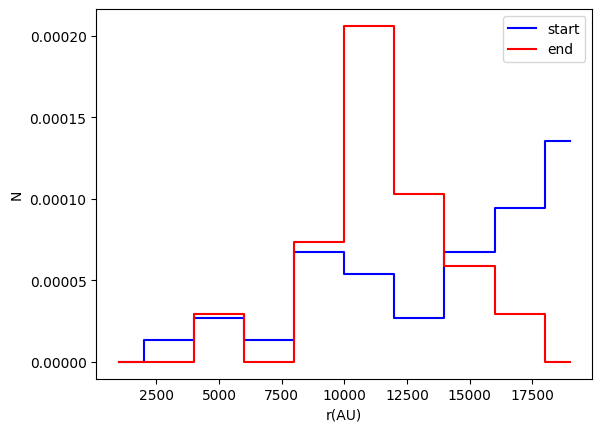

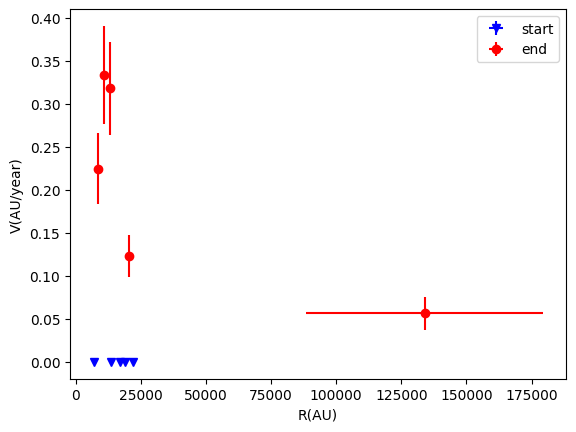

Fraction: 0.82  Updated Fraction 0.64


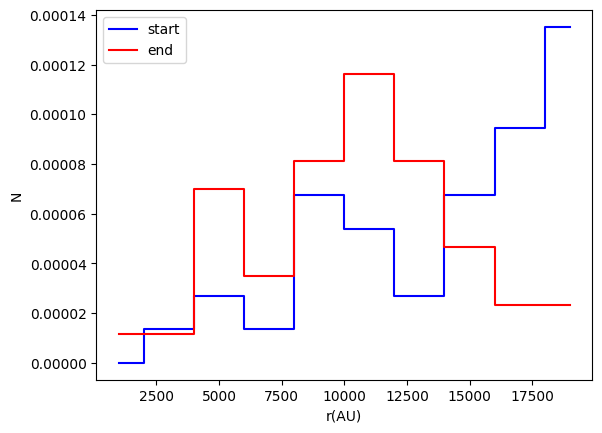

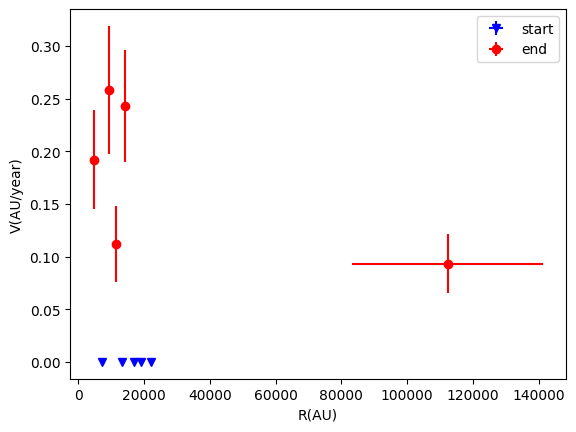

In [16]:
d=10000
tracks=allIntStar.history()
veltracks=allIntStar.velhistory()
frc0=fraction(tracks[0],d)
frc1=fraction(tracks[-1],d)
print("Fraction:",frc0," Updated Fraction",frc1)
plotRadius(tracks)
plotRotation(veltracks,tracks)

tracks=allStar.history()
veltracks=allStar.velhistory()
frc0=fraction(tracks[0],d)
frc1=fraction(tracks[-1],d)
print("Fraction:",frc0," Updated Fraction",frc1)
plotRadius(tracks)
plotRotation(veltracks,tracks)


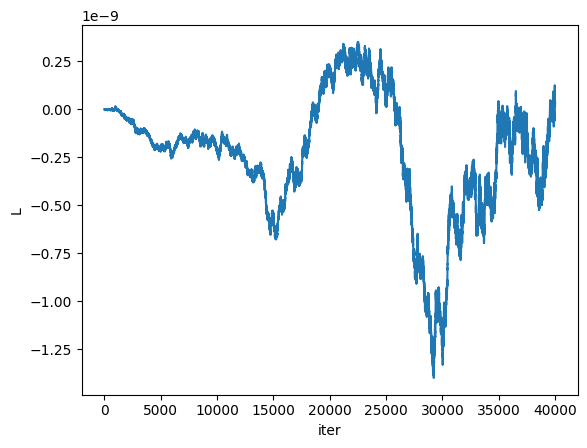

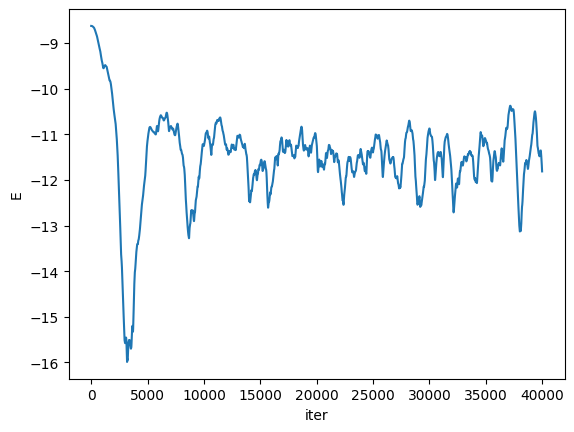

In [17]:
#PHIL-HERE-2
tracks=allIntStar.history()
veltracks=allIntStar.velhistory()
##Now some fun plots
def centerOfMassTime(iVec):
    center=np.mean(iVec,axis=1)
    return center

def shiftCOM(iR):
    center=centerOfMassTime(iR)
    shift=iR
    for pVal in range(iR.shape[1]):
        shift[:,pVal] -= center
    return shift

def angMomentumTime(iR,iV):
    shift=shiftCOM(iR)
    ang=shift[:,:,0]*iV[:,:,1]-shift[:,:,1]*iV[:,:,0]
    return np.sum(ang,axis=1)


Ltime=angMomentumTime(tracks,veltracks)
plt.plot(Ltime)
plt.xlabel("iter")
plt.ylabel("L")
plt.show()

enhist=allIntStar.enhistory()
enhisttot=np.sum(enhist,axis=1)
plt.plot(enhisttot)
plt.xlabel("iter")
plt.ylabel("E")
plt.show()

<!--start-block-->
<a name='section_4_6'></a>
<hr style="height: 1px;">

## <h2 style="border:1px; border-style:solid; padding: 0.25em; color: #FFFFFF; background-color: #90409C">P4.6 NN based Tau Id

| [Top](#section_4_0) | [Previous Section](#section_4_5) | [Problems](#problems_4_6) |

Now we are going to do a classic deep learning classificaiton problem. This uses real simulation that we are using for the current Tau Trigger in the CMS experiment. The strategy here is to build a deep learning algorithm that is small so we can embed this on a special chip that can run this neural network roughly 40 millions times per second to look for tau leptons. The output of this neural network is a probability of whether the object we pass into it is a tau or not. 

For this training, we will use 1 signal sample consisting of well defined taus from siulated Higgs to tau tau decys, and two backgrounds: the unbiased simulated background called minimum bias, a biased high momentum background sample of jets we will call QCD. The second sample enables the neural network to continue to work at high momentum well. In practice, you will not notice the two background samples, since we merge them for you before hand. Finally, we will train two neural networks a regression, and a discrimintor. This means we will have two truth values we want to train to, the true tau pT for the regression, and separating signal and background. 

To start with, we will just load the first variable in the dataset, this first variable is the going to be the leading particle momentum in a jet cone of particles. Ultimately, we will load the full 4 vectors and particle ids of the top 10 particles. 

You will also need 2 datasets available on dropbox here:
https://www.dropbox.com/scl/fi/kgsxcqdiji7fj8g7k70nx/test_bkg_v12_emseed.root?rlkey=itzrtjvwejqxs7vyzf4k75p0l&dl=0
https://www.dropbox.com/scl/fi/jdljan7gw8bt6n30b0rnm/test_sig_v12_emseed.root?rlkey=w7a5jqifr6u1kx0nm1ktbaq2z&dl=0

Signal Samples 100000 label: 1.0
Bkg Samples 100000 label: 0.0
QCD Samples 100000 label: 0.0


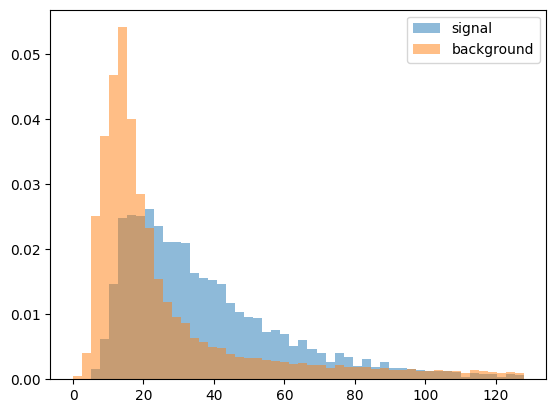

In [1]:
import random
import uproot
import torch
import numpy as np
import matplotlib.pyplot as plt

seed = 1111
random.seed(seed)
np.random.seed(seed)
torch.random.manual_seed(seed) 

def create_train_test_data(dir_path,iNVars=1,maxnum=100000):        
    #Might have to change the version for other ntuple files
    sig = uproot.open(dir_path+"data/test_sig_v12_emseed.root")
    bkg = uproot.open(dir_path+"data/test_bkg_v12_emseed.root")
    qcd = uproot.open(dir_path+"data/test_qcd_v12_emseed.root")

    sig_input = sig['ntuplePupSingle']['tree']['m_inputs'].array()
    bkg_input = bkg['ntuplePupSingle']['tree']['m_inputs'].array()
    qcd_input = qcd['ntuplePupSingle']['tree']['m_inputs'].array()

    truth_pt_sig = np.asarray(sig['ntuplePupSingle']['tree']['genpt1'].array())

    reco_pt_sig  = sig['ntuplePupSingle']['tree']['pt'].array()
    deltaR_sig   = sig['ntuplePupSingle']['tree']['gendr1'].array()
    eta_sig      = sig['ntuplePupSingle']['tree']['geneta1'].array()
    selection_sig = (reco_pt_sig > 12.) & (abs(deltaR_sig) < 0.4) & (abs(eta_sig) < 2.4)
    selection_bkg = (bkg['ntuplePupSingle']['tree']['pt'].array() > 12) 
    selection_qcd = (qcd['ntuplePupSingle']['tree']['pt'].array() > 12)

    #Inputs: pt, eta, phi, particle id(one hot encoded)
    X_sig = np.nan_to_num(np.asarray(sig_input[selection_sig][0:maxnum]))
    Y_sig = np.full(X_sig.shape[0], 1.)

    sig_pt = np.asarray(reco_pt_sig[selection_sig][0:maxnum])
    Y_sig_pT = truth_pt_sig[selection_sig][0:maxnum]

    X_bkg    = np.nan_to_num(np.asarray(bkg_input)[selection_bkg][0:maxnum])
    Y_bkg    = np.full(X_bkg.shape[0], 0.)
    Y_bkg_pT = np.ones(Y_bkg.shape)
    
    X_qcd    = np.nan_to_num(np.asarray(qcd_input)[selection_qcd][0:maxnum])
    Y_qcd    = np.full(X_qcd.shape[0], 0.)
    Y_qcd_pT = np.ones(Y_qcd.shape)
    
    print("Signal Samples",len(Y_sig),"label:",Y_sig[0])
    print("Bkg Samples",len(Y_bkg),"label:",Y_bkg[0])
    print("QCD Samples",len(Y_qcd),"label:",Y_qcd[0])
    
    X_train = np.concatenate([X_sig, X_bkg, X_qcd])
    Y_train_tauID = np.concatenate([Y_sig, Y_bkg, Y_qcd])
    Y_train_pT    = np.concatenate([Y_sig_pT / sig_pt, Y_bkg_pT, Y_qcd_pT])
    
    #cleaning
    X_train[abs(X_train) > 1e+9] = 0.    
    if iNVars > 0:
        X_train = X_train[:,0:iNVars]
    
    #convert to pytorch
    X_train       = torch.tensor(X_train, dtype=torch.float32)
    Y_train_tauID = torch.tensor(Y_train_tauID, dtype=torch.float32)
    Y_train_pT    = torch.tensor(Y_train_pT, dtype=torch.float32)
    return X_train, Y_train_tauID, Y_train_pT

X_train_tauID, Y_train_tauID,Y_train_pT_regress = create_train_test_data("")
plt.hist(X_train_tauID[:,0][Y_train_tauID == 1],bins=50,range=(0,128),label="signal",alpha=0.5,density=True)
plt.hist(X_train_tauID[:,0][Y_train_tauID == 0],bins=50,range=(0,128),label="background",alpha=0.5,density=True)
plt.legend()
plt.show()

### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.5.1</span>

Now we want to make to split the dataset into 3 components so that we can validate the training. These will be 

 * Train => This is the dataset we train the neural network on
 * Valid => Ths is the dataset that we use to check the loss doesn't overtrain while we train
 * Test  => This is the dataset that we use to test the performance
 
 In the code below, split the data into  20% testing and training, and then split training into a subsequent training and validation with 20% being for valdiation. What yields do you have for testing, training, and validation in [test,train,validation]

In [ ]:
def splitDataTestValid(iX,iY,test_frac=0.2,val_frac=0.2):
    alldataset = torch.utils.data.TensorDataset(iX,iY)
    #see https://pytorch.org/docs/stable/data.html
    testdataset, trainvaldataset = torch.utils.data.random_split(alldataset, [####,###])
    traindataset,valddataset     = torch.utils.data.random_split(trainvaldataset, [###,###])
    return testdataset,traindataset,valddataset

train,test,valid = splitDataTestValid(X_train_tauID, Y_train_tauID)
print(len(test),len(train),len(valid))

In [8]:
###Answer
def splitDataTestValid(iX,iY,test_frac=0.2,val_frac=0.2):
    alldataset = torch.utils.data.TensorDataset(iX,iY)
    #see https://pytorch.org/docs/stable/data.html
    testdataset, trainvaldataset = torch.utils.data.random_split(alldataset, [test_frac,1-test_frac])
    traindataset,valddataset     = torch.utils.data.random_split(trainvaldataset, [1-val_frac,val_frac])
    return testdataset,traindataset,valddataset

train,test,valid = splitDataTestValid(X_train_tauID, Y_train_tauID)
print(len(test),len(train),len(valid))

192000 60000 48000


<div style="border:1.5px; border-style:solid; padding: 0.5em; border-color: #90409C; color: #90409C;">

**SOLUTION:**

<pre>

[192000, 60000, 48000]

</pre>
        
**EXPLANATION:**
    
There are plenty of nice tools to split datasets quickly.
    
</div>


### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.5.2</span>

Ok, now lets create a one layer neural network that applys a sigmoid output to the output of that one layer. Create the network and then apply it directly to the test dataset, what is the mean output to 2 digits?

In [16]:
class NN_1layer(torch.nn.Module):
    def __init__(self,ninputs):
        super().__init__()
        self.fc1 = #one linear layer
        self.output = #apply a sigma

    def forward(self, x):
        x = self.fc1(x)
        x = self.output(x)
        return x

torch.random.manual_seed(1234) 
test_model = NN_1layer(1)
output = test_model(test[:][0])
print(output.mean())

SyntaxError: invalid syntax (427960810.py, line 4)

In [35]:
###Answer
class NN_1layer(torch.nn.Module):
    def __init__(self,ninputs):
        super().__init__()
        self.fc1 = torch.nn.Linear(ninputs,1)
        self.output = torch.nn.Sigmoid()

    def forward(self, x):
        x = self.fc1(x)
        x = self.output(x)
        return x

torch.random.manual_seed(1234) 
test_model = NN_1layer(1)
output = test_model(test[:][0])
print(output.mean())

tensor(0.0602, grad_fn=<MeanBackward0>)


<div style="border:1.5px; border-style:solid; padding: 0.5em; border-color: #90409C; color: #90409C;">

**SOLUTION:**

<pre>

0.06

</pre>
        
**EXPLANATION:**
   
When the NN is declared random weights are initialized, be sure to make sure the random seed is set correctly. 
    
</div>


### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.5.3</span>

Ok, now lets compute the loss for this network. Use Binary Cross entropy on the test dataset, what is your loss to 2 digits? 

In [259]:
criterion = ##Add binary cross entropy loss
loss = criterion(label,output.flatten())
print(loss)

SyntaxError: invalid syntax (1568614422.py, line 1)

In [24]:
#Answer
criterion = torch.nn.BCELoss()
loss = criterion(test[:][1],output.flatten())
print(loss)

tensor(38.3671, grad_fn=<BinaryCrossEntropyBackward0>)


<div style="border:1.5px; border-style:solid; padding: 0.5em; border-color: #90409C; color: #90409C;">

**SOLUTION:**

<pre>

38

</pre>
        
**EXPLANATION:**
    
The loss can be computed right away, note the gradient is also computed, this is the power of pytorch, the gradients are autocomputed. 
    
    
</div>


### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.5.4</span>

Ok, now lets do the whole training loop, we will write a function that takes the loss, model, and trains it with a fixed batchsize using dataloaders. What is the testing, training, validation loss after 10 epochs? [test,train,valid]

[1,   60] loss: 0.6087  val loss: 0.6102
[2,   60] loss: 0.6078  val loss: 0.6101
[3,   60] loss: 0.6077  val loss: 0.6120
[4,   60] loss: 0.6088  val loss: 0.6103
[5,   60] loss: 0.6081  val loss: 0.6104
[6,   60] loss: 0.6080  val loss: 0.6122
[7,   60] loss: 0.6086  val loss: 0.6101
[8,   60] loss: 0.6082  val loss: 0.6105
[9,   60] loss: 0.6089  val loss: 0.6106
[10,   60] loss: 0.6085  val loss: 0.6102


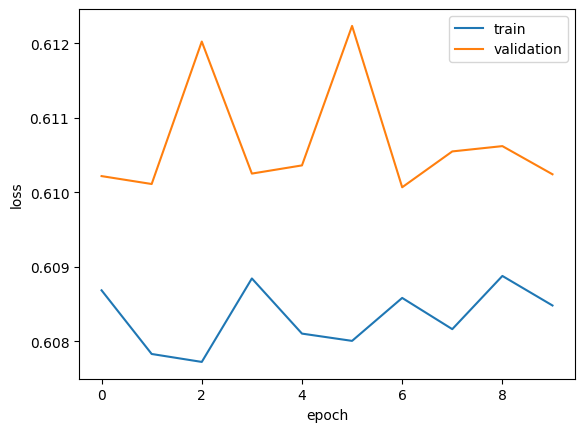

ValueError: Using a target size (torch.Size([192000])) that is different to the input size (torch.Size([192000, 1])) is deprecated. Please ensure they have the same size.

In [15]:
def train_model(iModel,iCriterion,iTrain,iValid,nepochs=5,learning_rate=0.01,iBatch=1000):
    optimizer   = #Use Adam optimizer with a learning rate of 0.01 
    history     = {'loss':[], 'val_loss':[]}
    #dataloaders to cache things (not really needed, but good to know)
    trainloader = torch.utils.data.DataLoader(iTrain,batch_size=iBatch,shuffle=True)
    valloader   = torch.utils.data.DataLoader(iValid,batch_size=iBatch,shuffle=True)
    
    for epoch in range(nepochs):
        current_loss = 0.0 #rezero loss
        for i, data in enumerate(trainloader):
            inputs, labels = data

            optimizer.zero_grad()
            outputs = #apply model
            loss = #apply loss
            #backpropagate loss
            #step optimizer
            current_loss += loss.item()
        
            if i == len(trainloader)-1:
                current_val_loss = 0.0
                with torch.no_grad():#disable updating gradient
                    for iv, vdata in enumerate(valloader):
                        val_inputs, val_labels = vdata
                        val_loss = #validation loss
                        current_val_loss += val_loss.item()
                    print('[%d, %4d] loss: %.4f  val loss: %.4f' % 
                          (epoch + 1, i + 1, current_loss/float(i+1) , current_val_loss/float(len(valloader))))
                history['loss'].append(current_loss/float(i+1))
                history['val_loss'].append(current_val_loss/float(len(valloader)))
    return history

history=train_model(test_model,criterion,train,valid,nepochs=10)
plt.plot(history['loss'],label='train')
plt.plot(history['val_loss'],label='validation')
plt.xlabel('epoch')
plt.ylabel('loss')
plt.legend()
plt.show()

testloss=criterion(test_model(test[:][0]),test[:][1])
print(testloss,history['loss'][-1],history['val_loss'][-1])

[1,   60] loss: 12.3263  val loss: 6.5633
[2,   60] loss: 1.5201  val loss: 0.7437
[3,   60] loss: 0.7000  val loss: 0.6650
[4,   60] loss: 0.6454  val loss: 0.6324
[5,   60] loss: 0.6229  val loss: 0.6184
[6,   60] loss: 0.6138  val loss: 0.6130
[7,   60] loss: 0.6097  val loss: 0.6110
[8,   60] loss: 0.6084  val loss: 0.6133
[9,   60] loss: 0.6087  val loss: 0.6107
[10,   60] loss: 0.6077  val loss: 0.6103


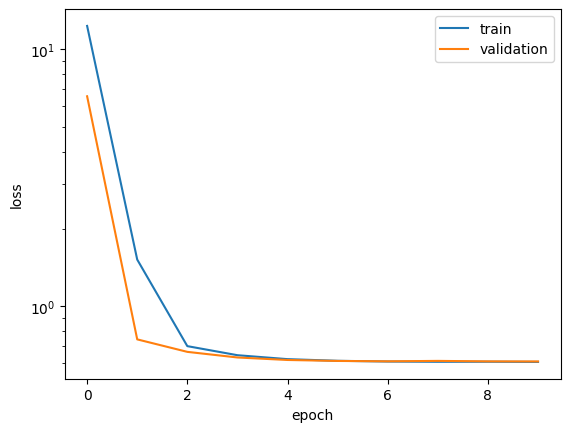

0.6076597899198533 0.6102540654440721 tensor(0.6096, grad_fn=<BinaryCrossEntropyBackward0>)


In [25]:
def train_model(iModel,iCriterion,iTrain,iValid,nepochs=5,learning_rate=0.01,iBatch=1000):
    optimizer   = torch.optim.Adam(iModel.parameters(), lr=learning_rate) 
    history     = {'loss':[], 'val_loss':[]}
    trainloader = torch.utils.data.DataLoader(iTrain,batch_size=iBatch,shuffle=True)
    valloader   = torch.utils.data.DataLoader(iValid,batch_size=iBatch,shuffle=True)
    
    for epoch in range(nepochs):
        current_loss = 0.0 #rezero loss
        for i, data in enumerate(trainloader):
            inputs, labels = data
            optimizer.zero_grad()

            outputs = iModel(inputs)
            loss = iCriterion(outputs.flatten(), labels)
            loss.backward()
            optimizer.step()
            current_loss += loss.item()
        
            if i == len(trainloader)-1:
                current_val_loss = 0.0
                with torch.no_grad():#disable updating gradient
                    for iv, vdata in enumerate(valloader):
                        val_inputs, val_labels = vdata
                        val_loss = iCriterion(iModel(val_inputs).flatten(), val_labels)
                        current_val_loss += val_loss.item()
                    print('[%d, %4d] loss: %.4f  val loss: %.4f' % 
                          (epoch + 1, i + 1, current_loss/float(i+1) , current_val_loss/float(len(valloader))))
                history['loss'].append(current_loss/float(i+1))
                history['val_loss'].append(current_val_loss/float(len(valloader)))
    return history

history=train_model(test_model,criterion,train,valid,nepochs=10)
plt.plot(history['loss'],label='train')
plt.plot(history['val_loss'],label='validation')
plt.xlabel('epoch')
plt.ylabel('loss')
plt.legend()
plt.yscale("log")
plt.show()

trainloss=criterion(test_model(test[:][0]).flatten(),test[:][1])
print(history['loss'][-1],history['val_loss'][-1],trainloss)

<div style="border:1.5px; border-style:solid; padding: 0.5em; border-color: #90409C; color: #90409C;">

**SOLUTION:**

<pre>

[0.610, 0.607, 0.610]

</pre>
        
**EXPLANATION:**
    
All the losses are very close
    
</div>


### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.5.5 </span>

Now lets test the performance of this discriminator by computing a ROC curve. To do this, we will

a) plot the signal and background output of the neural network
b) compute the Reciever operator chacteristic
c) Compute the Area under a curve (AUC)

What is the AUC you achieve? 

In [ ]:
from sklearn import metrics


output=#compute the output on thee test dataset
label=#labels on the test dataset

#now plot it
plt.hist(output[label==0].detach().numpy(),histtype='step',color='r',density=True,label='bkg',bins=30)
plt.hist(output[label==1].detach().numpy(),histtype='step',color='b',density=True,label='signal',bins=30)
plt.xlabel('NN Discriminant')
plt.ylabel('N')
plt.legend()
plt.show()

def compute_ROC(labels, predicts, npts=501):
    cutvals = #make a line from min to max with npoints
    tot0 = float(len(labels[labels==0]))#bkg
    tot1 = float(len(labels[labels==1]))#sig
    tpr = []
    fpr = []
    for c in cutvals:
        passbkg=#condition for label=0 and prediction > c (aka cutval)
        passsig=#condition for label=1 and prediction > c (aka cutval)
        fpr.append(float(len(predicts[passbkg]))/tot0)
        tpr.append(float(len(predicts[passsig]))/tot1)
    return np.array(fpr),np.array(tpr)

test_model_roc = compute_ROC(label,output)
plt.plot(test_model_roc[0],test_model_roc[1],'g-',label="NN")
plt.title("ROC (Receiver Operating Characteristic) Curve")
plt.xlabel("False Positive Rate (FPR) aka Background Efficiency")
plt.ylabel("True Positive Rate (TPR) aka Signal Efficiency")
plt.legend(loc="lower right")
plt.show()

print("AUC:",metrics.auc(#compute AUC))

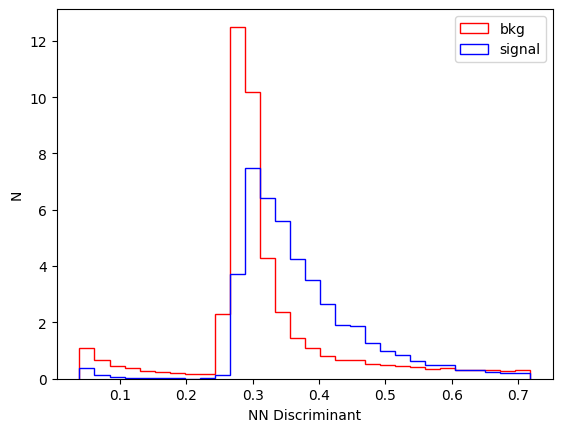

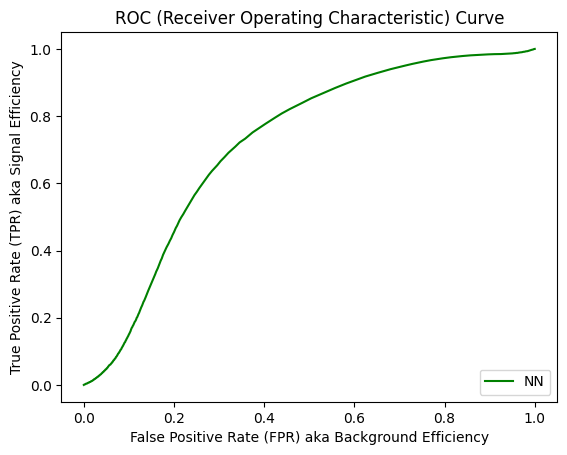

AUC: 0.7201492145971679


In [34]:
from sklearn import metrics

def compute_ROC(labels, predicts, npts=501):
    cutvals = np.linspace(0.,1.,num=npts)
    tot0 = float(len(labels[labels==0]))
    tot1 = float(len(labels[labels==1]))
    tpr = []
    fpr = []
    for c in cutvals:
        fpr.append(float(len(predicts[(labels==0) & (predicts>c)]))/tot0)
        tpr.append(float(len(predicts[(labels==1) & (predicts>c)]))/tot1)
    return np.array(fpr),np.array(tpr)


output=test_model(test[:][0]).flatten()
label=test[:][1]
plt.hist(output[label==0].detach().numpy(),histtype='step',color='r',density=True,label='bkg',bins=30)
plt.hist(output[label==1].detach().numpy(),histtype='step',color='b',density=True,label='signal',bins=30)
plt.xlabel('NN Discriminant')
plt.ylabel('N')
plt.legend()
plt.show()

test_model_roc = compute_ROC(label,output)
plt.plot(test_model_roc[0],test_model_roc[1],'g-',label="NN")
plt.title("ROC (Receiver Operating Characteristic) Curve")
plt.xlabel("False Positive Rate (FPR) aka Background Efficiency")
plt.ylabel("True Positive Rate (TPR) aka Signal Efficiency")
plt.legend(loc="lower right")
plt.show()

print("AUC:",metrics.auc(test_model_roc[0],test_model_roc[1]))

<div style="border:1.5px; border-style:solid; padding: 0.5em; border-color: #90409C; color: #90409C;">

**SOLUTION:**

<pre>

0.72

</pre>
        
**EXPLANATION:**
    
Area under a curve requires the roc computation, we typically use sklearn tools for this
    
</div>


### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.5.6</span>

Ok, Now we have run through a very simple NN. Lets go ahead and load the full dataset and train, start with 10 epochs. The full dataset has 80 inputs, these inputs start form a jet (a cone in a collision):

 * pT of the first particle
 * theta (really eta) of the first particle from the center of the jet
 * phi of the first particle from the center of the jet
 * one hot coded id of the particle  (this is a vector of 5 elements that are zero or 1)
   * [pion, electron, muon, photon, neutral hadron]
 * the above 8 variables for the top 10 particles in the jet
 
What is the [test,train,valid] loss after 10 epochs? 

In [ ]:
X_train_tauID, Y_train_tauID,Y_train_pT_regress = create_train_test_data("",iNVars=-1)
train,test,valid = splitDataTestValid(X_train_tauID, Y_train_tauID)
print(train[:][0].shape)
test_model = #make 1 layer NN
history=#train this guy
plt.plot(history['loss'],label='train')
plt.plot(history['val_loss'],label='validation')
plt.xlabel('epoch')
plt.ylabel('loss')
plt.legend()
plt.yscale("log")
plt.show()

trainloss=#apply this to the test loss
print(testloss,history['loss'][-1],history['val_loss'][-1])

Signal Samples 100000 label: 1.0
Bkg Samples 100000 label: 0.0
QCD Samples 100000 label: 0.0
80
[1,   60] loss: 0.4945  val loss: 0.4330
[2,   60] loss: 0.4181  val loss: 0.4150
[3,   60] loss: 0.4103  val loss: 0.4114
[4,   60] loss: 0.4067  val loss: 0.4099
[5,   60] loss: 0.4039  val loss: 0.4097
[6,   60] loss: 0.4036  val loss: 0.4077
[7,   60] loss: 0.4026  val loss: 0.4088
[8,   60] loss: 0.4021  val loss: 0.4065
[9,   60] loss: 0.4020  val loss: 0.4070
[10,   60] loss: 0.4019  val loss: 0.4078


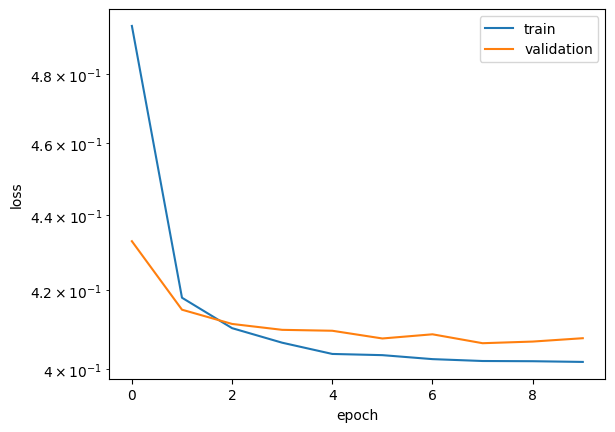

0.401873879134655 0.40780144184827805 tensor(0.4049, grad_fn=<BinaryCrossEntropyBackward0>)


In [49]:
X_train_tauID, Y_train_tauID,Y_train_pT_regress = create_train_test_data("",iNVars=-1)
train,test,valid = splitDataTestValid(X_train_tauID, Y_train_tauID)
print(train[:][0].shape)
test_model = NN_1layer(train[:][0].shape[1])
history=train_model(test_model,criterion,train,valid,nepochs=10)
plt.plot(history['loss'],label='train')
plt.plot(history['val_loss'],label='validation')
plt.xlabel('epoch')
plt.ylabel('loss')
plt.legend()
plt.yscale("log")
plt.show()

testloss=criterion(test_model(test[:][0]).flatten(),test[:][1])
print(testloss,history['loss'][-1],history['val_loss'][-1])

<div style="border:1.5px; border-style:solid; padding: 0.5em; border-color: #90409C; color: #90409C;">

**SOLUTION:**

<pre>

[0.405, 0.402, 0.408]

</pre>
        
**EXPLANATION:**
    
The validation loss is starting to appear significantly larger. This might be a sign, we are over traininng. Lets make a larger network. 
    
</div>


### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.5.7</span>

Ok, Now Lets go ahead and build a 3 layer network with relu activations, and 50 hidden parameters, for the intermediate layers. What is the [test,train,valid] loss after 10 epochs? 

In [ ]:
class NN_3layer(torch.nn.Module):
    def __init__(self,ninputs):
        super().__init__()
        self.fc1 = #one linear layer
        self.act1 = #Relu activation
        self.fc2 = #one linear layer
        self.act2 = #Relu activation
        self.fc3 = #one linear layer
        self.output = #apply a sigmoid

    def forward(self, x):
        x = self.fc1(x)
        x = self.act1(x)
        x = self.fc2(x)
        x = self.act2(x)
        x = self.fc3(x)
        x = self.output(x)
        return x

torch.random.manual_seed(1234) 
test_model = NN_3layer()
history=train_model(test_model,criterion,train,valid,nepochs=10)
plt.plot(history['loss'],label='train')
plt.plot(history['val_loss'],label='validation')
plt.xlabel('epoch')
plt.ylabel('loss')
plt.legend()
plt.yscale("log")
plt.show()

testloss=#Test loss
print(testloss,history['loss'][-1],history['val_loss'][-1])

[1,   60] loss: 0.4149  val loss: 0.3468
[2,   60] loss: 0.3288  val loss: 0.3235
[3,   60] loss: 0.3210  val loss: 0.3185
[4,   60] loss: 0.3170  val loss: 0.3189
[5,   60] loss: 0.3127  val loss: 0.3193
[6,   60] loss: 0.3125  val loss: 0.3186
[7,   60] loss: 0.3091  val loss: 0.3153
[8,   60] loss: 0.3099  val loss: 0.3241
[9,   60] loss: 0.3097  val loss: 0.3155
[10,   60] loss: 0.3076  val loss: 0.3235


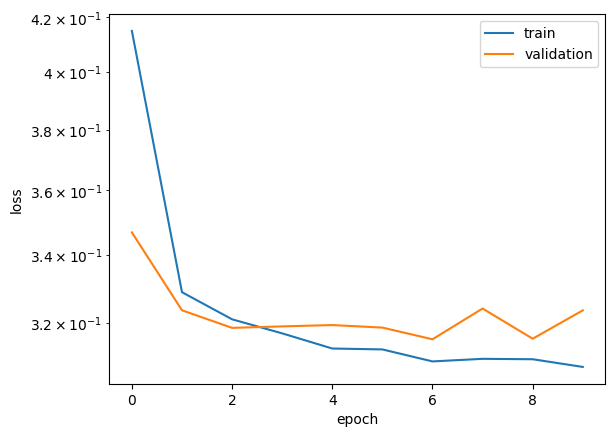

tensor(0.3190, grad_fn=<BinaryCrossEntropyBackward0>) 0.3076336259643237 0.323528445015351


In [54]:
class NN_3layer(torch.nn.Module):
    def __init__(self,ninputs,nhidden=50):
        super().__init__()
        self.fc1 = torch.nn.Linear(ninputs,nhidden)
        self.act1 = torch.nn.ReLU()
        self.fc2 = torch.nn.Linear(nhidden,nhidden)
        self.act2 = torch.nn.ReLU()
        self.fc3 = torch.nn.Linear(nhidden,1)
        self.output = torch.nn.Sigmoid()

    def forward(self, x):
        x = self.fc1(x)
        x = self.act1(x)
        x = self.fc2(x)
        x = self.act2(x)
        x = self.fc3(x)
        x = self.output(x)
        return x

torch.random.manual_seed(1234) 
test_model = NN_3layer(train[:][0].shape[1])
history=train_model(test_model,criterion,train,valid,nepochs=10)
plt.plot(history['loss'],label='train')
plt.plot(history['val_loss'],label='validation')
plt.xlabel('epoch')
plt.ylabel('loss')
plt.legend()
plt.yscale("log")
plt.show()

testloss=criterion(test_model(test[:][0]).flatten(),test[:][1])
print(testloss,history['loss'][-1],history['val_loss'][-1])

<div style="border:1.5px; border-style:solid; padding: 0.5em; border-color: #90409C; color: #90409C;">

**SOLUTION:**

<pre>

[0.319, 0.308, 0.323]

</pre>
        
**EXPLANATION:**

The loss drops substantially from the 1 layer, it might not be the end, we can try to add more hidden parameters or layer, we lave this as an exercise for the student. 
    
</div>


### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.5.8</span>

Ok, lets train this guy for another 30 epochs, what happens to the losses? 

In [ ]:
history=train_model(test_model,criterion,train,valid,nepochs=###)
plt.plot(history['loss'],label='train')
plt.plot(history['val_loss'],label='validation')
plt.xlabel('epoch')
plt.ylabel('loss')
plt.legend()
plt.show()

testloss=criterion(test_model(test[:][0]).flatten(),test[:][1])
print(testloss, history['loss'][-1],history['val_loss'][-1])

[1,   60] loss: 0.3108  val loss: 0.3208
[2,   60] loss: 0.3076  val loss: 0.3131
[3,   60] loss: 0.3072  val loss: 0.3209
[4,   60] loss: 0.3072  val loss: 0.3195
[5,   60] loss: 0.3062  val loss: 0.3142
[6,   60] loss: 0.3039  val loss: 0.3157
[7,   60] loss: 0.3041  val loss: 0.3169
[8,   60] loss: 0.3026  val loss: 0.3133
[9,   60] loss: 0.3023  val loss: 0.3146
[10,   60] loss: 0.3019  val loss: 0.3152
[11,   60] loss: 0.3008  val loss: 0.3142
[12,   60] loss: 0.3004  val loss: 0.3154
[13,   60] loss: 0.2996  val loss: 0.3159
[14,   60] loss: 0.2981  val loss: 0.3163
[15,   60] loss: 0.2983  val loss: 0.3147
[16,   60] loss: 0.2968  val loss: 0.3149
[17,   60] loss: 0.3007  val loss: 0.3138
[18,   60] loss: 0.2963  val loss: 0.3129
[19,   60] loss: 0.2964  val loss: 0.3148
[20,   60] loss: 0.2938  val loss: 0.3169
[21,   60] loss: 0.2935  val loss: 0.3181
[22,   60] loss: 0.2943  val loss: 0.3197
[23,   60] loss: 0.2933  val loss: 0.3165
[24,   60] loss: 0.2926  val loss: 0.3174
[

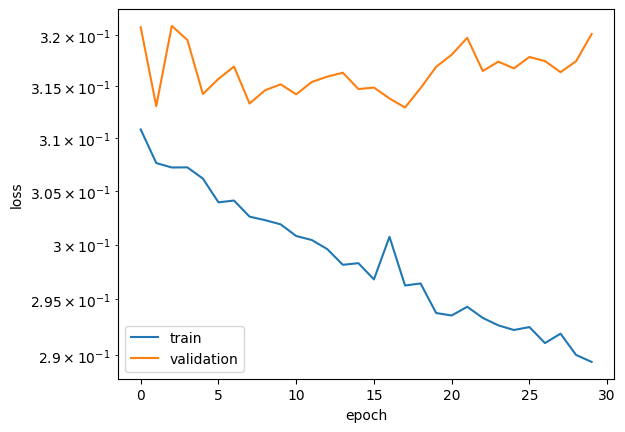

tensor(0.3193, grad_fn=<BinaryCrossEntropyBackward0>) 0.28936723073323567 0.3200841515014569


In [55]:
history=train_model(test_model,criterion,train,valid,nepochs=30)
plt.plot(history['loss'],label='train')
plt.plot(history['val_loss'],label='validation')
plt.xlabel('epoch')
plt.ylabel('loss')
plt.legend()
plt.yscale("log")
plt.show()

testloss=criterion(test_model(test[:][0]).flatten(),test[:][1])
print(testloss, history['loss'][-1],history['val_loss'][-1])

<div style="border:1.5px; border-style:solid; padding: 0.5em; border-color: #90409C; color: #90409C;">

**SOLUTION:**

<pre>

[0.319, 0.289, 0.320]

</pre>
        
**EXPLANATION:**
    
We are now overtraining, the training loss is way to low compared to the testing and validation. This is a sign that the NN is learning features in the training data. 
    
</div>


### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.5.9</span>

Ok, now what is the AUC? and the ROC curve.

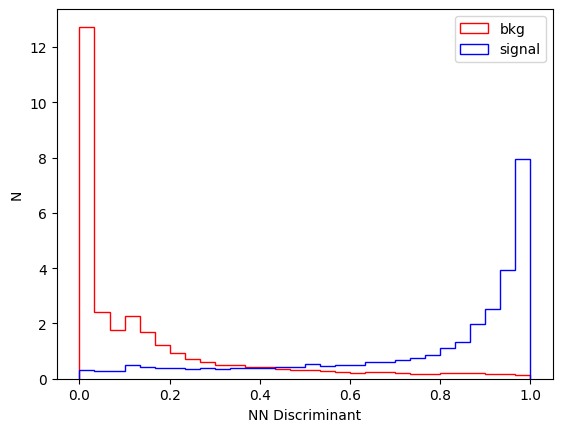

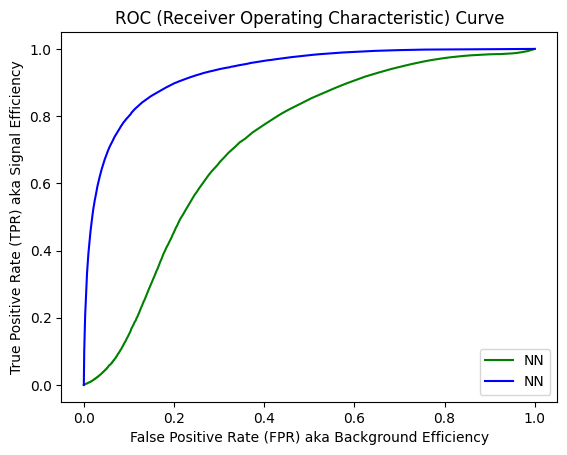

AUC: 0.9309708497750019


In [57]:
output=test_model(test[:][0]).flatten()
label=test[:][1]
plt.hist(output[label==0].detach().numpy(),histtype='step',color='r',density=True,label='bkg',bins=30)
plt.hist(output[label==1].detach().numpy(),histtype='step',color='b',density=True,label='signal',bins=30)
plt.xlabel('NN Discriminant')
plt.ylabel('N')
plt.legend()
plt.show()

test_model_roc_update = compute_ROC(label,output)
plt.plot(test_model_roc[0],test_model_roc[1],'g-',label="NN")
plt.plot(test_model_roc_update[0],test_model_roc_update[1],'b-',label="NN")
plt.title("ROC (Receiver Operating Characteristic) Curve")
plt.xlabel("False Positive Rate (FPR) aka Background Efficiency")
plt.ylabel("True Positive Rate (TPR) aka Signal Efficiency")
plt.legend(loc="lower right")
plt.show()

print("AUC:",metrics.auc(test_model_roc_update[0],test_model_roc_update[1]))

<div style="border:1.5px; border-style:solid; padding: 0.5em; border-color: #90409C; color: #90409C;">

**SOLUTION:**

<pre>

AUC of 0.93

</pre>
        
**EXPLANATION:**
    
Peformance is now much better, we clearly see this in the AUC.
    
</div>


### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.5.10</span>

Now apply a cut on the discriminator and compute the efficiency vs leading particle pt (first input) what is the NN doing? lets the efficiency to 2 digits for pt = 30 GeV and pt = 100 GeV?

In [ ]:
passcut = #cut on NN at crossing point

countsS,bins,_ = plt.hist(test[:][0][:,0][###signal],bins=50,range=(0,128),label="signal",alpha=0.5)
countsB,bins,_ = plt.hist(test[:][0][:,0][###bkg],bins=50,range=(0,128),label="background",alpha=0.5)
countsSC,bins,_ = plt.hist(test[:][0][:,0][(###signal) & passcut],bins=50,range=(0,128),label="signal(pass)",alpha=0.5)
countsBC,bins,_ = plt.hist(test[:][0][:,0][(###bkg) & passcut],bins=50,range=(0,128),label="background(pass)",alpha=0.5)
plt.legend()
plt.xlabel("lead pT(GeV)")
plt.ylabel("N")
plt.show()

bincenter = 0.5*(bins[1:] + bins[:-1])
plt.plot(bincenter,countsSC/countsS,marker='.',label='signal')
plt.plot(bincenter,countsBC/countsB,marker='.',label='bkg')
plt.legend()
plt.ylabel('eff')
plt.xlabel("lead pT(GeV)")
plt.show()


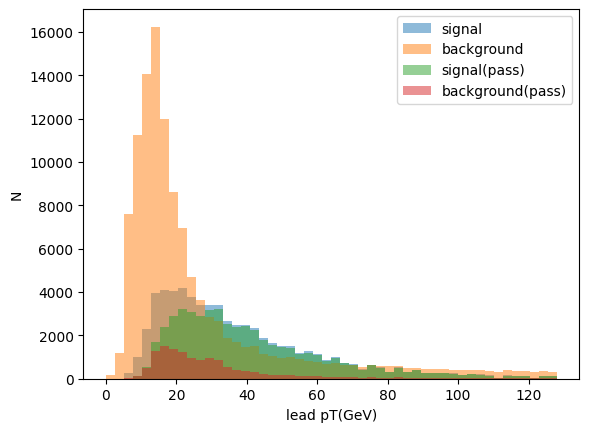

/var/folders/4t/mwl83f3x1ls0jvy35v4qzj7c0000gp/T/ipykernel_63071/267907472.py:12: RuntimeWarning: invalid value encountered in divide
  plt.plot(bincenter,countsSC/countsS,marker='.',label='signal')


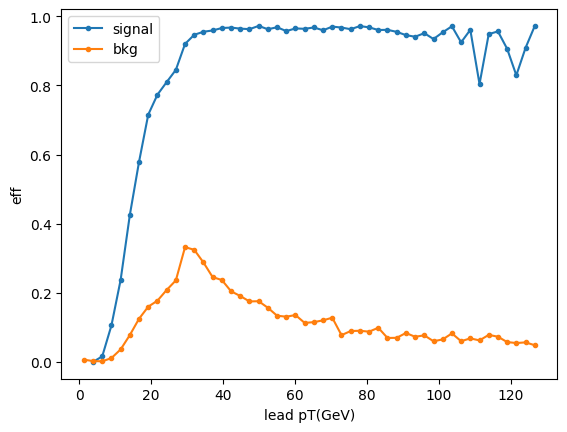

In [84]:
passcut = test_model(test[:][0]).flatten() > 0.5
countsS,bins,_ = plt.hist(test[:][0][:,0][test[:][1] == 1],bins=50,range=(0,128),label="signal",alpha=0.5)
countsB,bins,_ = plt.hist(test[:][0][:,0][test[:][1] == 0],bins=50,range=(0,128),label="background",alpha=0.5)
countsSC,bins,_ = plt.hist(test[:][0][:,0][(test[:][1] == 1) & passcut],bins=50,range=(0,128),label="signal(pass)",alpha=0.5)
countsBC,bins,_ = plt.hist(test[:][0][:,0][(test[:][1] == 0) & passcut],bins=50,range=(0,128),label="background(pass)",alpha=0.5)
plt.legend()
plt.xlabel("lead pT(GeV)")
plt.ylabel("N")
plt.show()

bincenter = 0.5*(bins[1:] + bins[:-1])
plt.plot(bincenter,countsSC/countsS,marker='.',label='signal')
plt.plot(bincenter,countsBC/countsB,marker='.',label='bkg')
plt.legend()
plt.ylabel('eff')
plt.xlabel("lead pT(GeV)")
plt.show()


<div style="border:1.5px; border-style:solid; padding: 0.5em; border-color: #90409C; color: #90409C;">

**SOLUTION:**

<pre>
[Bkg20,Sig20,Bkg100,Sig100] ( unc is within 0.1)
[0.35,0.9,0.1,0.95]

</pre>
        
**EXPLANATION:**
    
Our training is really dependent on the dataset, but lets in the most background for a 30 GeV leading particle. For higher pT it can discrminate well, for lower it cuts both signal and background. 
    
</div>


### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.5.11</span>

Finally, lets see if we can use this NN to find a hidden signal in the data. We will construct a dataset with a mystery mass peak comprising two taus that is injected to background events at the 1.5 percent level (750 events in 50k). Given the output variables of the two taus, find the mass of the hidden signal? (note this is hard, especially to do it convincingly)

In [ ]:
from pylorentz import Momentum4

def masscompute(iVec1,iVec2):
    tau_1 = Momentum4.m_eta_phi_pt(iVec1[3], iVec1[1], iVec1[2], iVec1[0])
    tau_2 = Momentum4.m_eta_phi_pt(iVec2[3], iVec2[1], iVec2[2], iVec2[0])
    return (tau_1+tau_2).m

    
def mass_inputsdset(massfunc,idataset):
    mask=(idataset["pt2"].array() > 0)# & abs(idataset["eta2"].array()) < 2.1)
    mask=(abs(idataset["eta2"].array()) < 2.1) & mask
    varlist=["pt1","eta1","phi1","m1","pt2","eta2","phi2","m2"]
    arr=0
    idx=0
    for x in varlist:
        pArr=idataset[x].array(library="np")[mask]
        if idx == 0: 
            arr = pArr
            idx = idx + 1
        else:
            arr=np.vstack((arr,pArr))
    arr = arr.T
    massc = lambda iarr: massfunc(iarr[0:4],iarr[4:8]) 
    hmasses = np.array([massc(p) for p in arr[0:50000]])
    inputs1 = idataset['m1_inputs'].array()
    inputs2 = idataset['m2_inputs'].array()
    inputs1 = np.nan_to_num(np.asarray(inputs1)[mask][0:50000])
    inputs2 = np.nan_to_num(np.asarray(inputs2)[mask][0:50000])
    return hmasses,inputs1,inputs2
    
def create_double_train_test_data(dir_path):
    sig = uproot.open(dir_path+"data/test_sig_v12_emseed.root")
    bkg = uproot.open(dir_path+"data/test_bkg_v12_emseed.root")
    mvissig,in1_sig,in2_sig = mass_inputsdset(masscompute,sig['ntuplePupDiTau']['tree'])
    mvisbkg,in1_bkg,in2_bkg = mass_inputsdset(masscompute,bkg['ntuplePupDiTau']['tree'])
    masscut = ( mvissig > mvissig[0]/1.8) &  (mvissig < mvissig[0]/1.2)
    mvissig          = mvissig[masscut]
    in1_sig[masscut] = in1_sig[masscut]
    in2_sig[masscut] = in2_sig[masscut]
    return mvis_mix,in1_mix,in2_mix
        
                        
    
m_mix,in1_mix,in2_mix= create_double_train_test_data("")
val=0.
selection  = #apply NN to both legs and cut
plt.hist(m_mix,bins=50,range=(0,200),color='gray',label="mix",alpha=0.5)
plt.hist(m_mix[selection],bins=25,range=(0,200),color='blue',label="selection",alpha=0.5)
plt.legend()
plt.show()

In [124]:
sig = uproot.open("data/test_sig_v12_emseed.root")
print(sig['ntuplePupDiTau']['tree'].keys())

['run', 'lumi', 'event', 'event2', 'gendr1', 'genpt1', 'geneta1', 'genphi1', 'genid1', 'gendr2', 'genpt2', 'geneta2', 'genphi2', 'genid2', 'chargedIso1', 'chargedIso2', 'decayId1', 'decayId2', 'dxy1', 'dxy2', 'eta1', 'eta2', 'fullIso1', 'fullIso2', 'm1', 'm2', 'passLoose1', 'passLoose2', 'passTight1', 'passTight2', 'phi1', 'phi2', 'pt1', 'pt2', 'z01', 'z02', 'm1_inputs', 'm2_inputs']


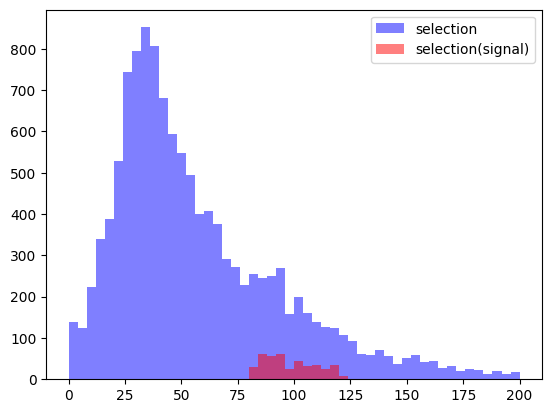

tensor(98.5107)


In [198]:
from pylorentz import Momentum4

def masscompute(iVec1,iVec2):
    tau_1 = Momentum4.m_eta_phi_pt(iVec1[3], iVec1[1], iVec1[2], iVec1[0])
    tau_2 = Momentum4.m_eta_phi_pt(iVec2[3], iVec2[1], iVec2[2], iVec2[0])
    return (tau_1+tau_2).m

    
def mass_inputsdset(massfunc,idataset):
    mask=(idataset["pt2"].array() > 0)# & abs(idataset["eta2"].array()) < 2.1)
    mask=(abs(idataset["eta2"].array()) < 2.1) & mask
    #mask=(idataset["passLoose1"].array() > 0) & mask
    #mask=(idataset["passLoose2"].array() > 0) & mask
    #varlist=["pt1","eta1","phi1","m1","pt2","eta2","phi2","m2"]
    varlist=["pt1","eta1","phi1","m1","pt2","eta2","phi2","m2"]
    arr=0
    idx=0
    for x in varlist:
        pArr=idataset[x].array(library="np")[mask]
        if idx == 0: 
            arr = pArr
            idx = idx + 1
        else:
            arr=np.vstack((arr,pArr))
    arr = arr.T
    massc = lambda iarr: massfunc(iarr[0:4],iarr[4:8]) 
    hmasses = np.array([massc(p) for p in arr[0:50000]])
    inputs1 = idataset['m1_inputs'].array()
    inputs2 = idataset['m2_inputs'].array()
    inputs1 = np.nan_to_num(np.asarray(inputs1)[mask][0:50000])
    inputs2 = np.nan_to_num(np.asarray(inputs2)[mask][0:50000])
    return hmasses,inputs1,inputs2
    
def create_double_train_test_data(dir_path):
    sig = uproot.open(dir_path+"data/test_sig_v12_emseed.root")
    bkg = uproot.open(dir_path+"data/test_bkg_v12_emseed.root")
    mvissig,in1_sig,in2_sig = mass_inputsdset(masscompute,sig['ntuplePupDiTau']['tree'])
    mvisbkg,in1_bkg,in2_bkg = mass_inputsdset(masscompute,bkg['ntuplePupDiTau']['tree'])
    masscut = ( mvissig > mvissig[0]/1.8) &  (mvissig < mvissig[0]/1.2)
    mvissig          = mvissig[masscut]
    in1_sig[masscut] = in1_sig[masscut]
    in2_sig[masscut] = in2_sig[masscut]
    mvis_mix = torch.tensor(np.append(mvisbkg[0:50000],mvissig[0:750]), dtype=torch.float32)
    in1_mix  = torch.tensor(np.vstack([in1_bkg[0:50000],in1_sig[0:750]]), dtype=torch.float32)
    in2_mix  = torch.tensor(np.vstack([in2_bkg[0:50000],in2_sig[0:750]]), dtype=torch.float32)

    mvis_mix1 = torch.tensor(mvissig[0:750], dtype=torch.float32)
    in1_mix1  = torch.tensor(in1_sig[0:750], dtype=torch.float32)
    in2_mix1  = torch.tensor(in2_sig[0:750], dtype=torch.float32)
    return mvis_mix,in1_mix,in2_mix,mvis_mix1,in1_mix1,in2_mix1
    #plt.hist(rawmvissig,bins=50,range=(0,200),color='blue',label="sig",alpha=0.5,density=True)
    #plt.hist(rawmvisbkg,bins=50,range=(0,200),color='red',label="bkg",alpha=0.5,density=True)
    #plt.hist(mixture,bins=50,range=(0,200),color='gray',label="mix",alpha=0.5,density=True)
    #plt.legend()
    #plt.show()
        
                        
    
#m_mix,in1_mix,in2_mix,m_mix1,in1_mix1,in2_mix1 = create_double_train_test_data("")
val=0.1
selection  = (test_model(in1_mix).flatten() > val) &(test_model(in2_mix).flatten() > val)
selection1 = (test_model(in1_mix1).flatten() > val) &(test_model(in2_mix1).flatten() > val)
#plt.hist(m_mix,bins=50,range=(0,200),color='gray',label="mix",alpha=0.5)
plt.hist(m_mix[selection],bins=50,range=(0,200),color='blue',label="selection",alpha=0.5)
plt.hist(m_mix1[selection1],bins=50,range=(0,200),color='red',label="selection(signal)",alpha=0.5)
plt.legend()
plt.show()

print(m_mix1[selection1].mean())


<div style="border:1.5px; border-style:solid; padding: 0.5em; border-color: #90409C; color: #90409C;">

**SOLUTION:**

<pre>
98 +/- 10
</pre>
        
**EXPLANATION:**

By cutting on the discriminator, we isolate more and more Higgs events. However, its very hard to tell the background shape and convince yourself you are seeing a peak. At least we can get somewhere with the NN

</div>
